In [1]:
import sys
sys.path.append('../')
%load_ext autoreload
%autoreload 3

import xarray as xr
import matplotlib.pyplot as plt
from helpers.computational_tools import *

from helpers.collection_of_experiments import CollectionOfExperiments

In [2]:
ds = CollectionOfExperiments.init_folder('/scratch/js15017/OM4_storage/CORE-AIF-runs', additional_subfolder='', Averaging_time=slice('1981', '2007'))

(3.5e+20, 4e+20)

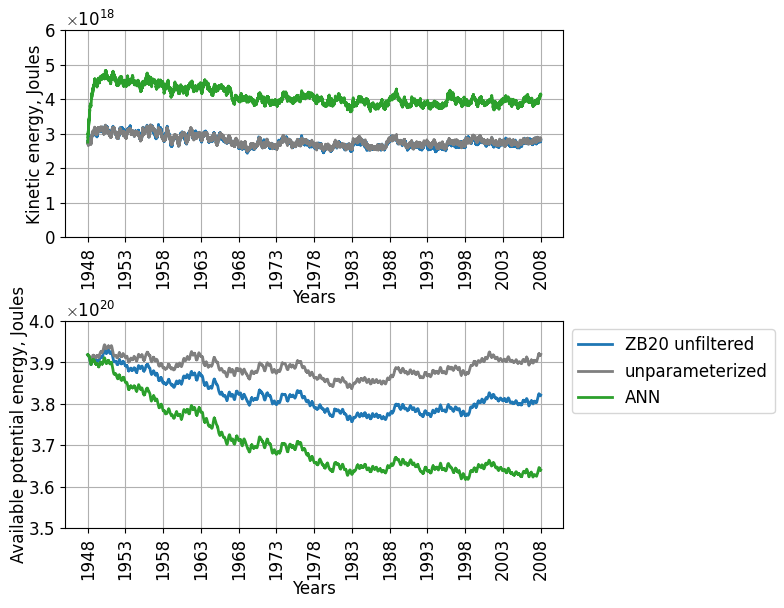

In [3]:
ds.plot_series(['ZB20', 'unparameterized', 'ANN'], CFL=False, colors=['tab:blue', 'tab:gray', 'tab:green'], labels=['ZB20 unfiltered', 'unparameterized', 'ANN'])
for j in range(2):
    plt.subplot(2,1,j+1)
    plt.xticks(np.array([0,5,10,15,20,25,30,35,40,45,50,55,60])*365, 1948 + np.array([0,5,10,15,20,25,30,35,40,45,50,55,60]), rotation=90)

plt.ylim([3.5e+20, 4e+20])

# UMO vs UO

In [9]:
umo = ds['unparameterized'].ocean_month_z.umo.isel(time=-1,zl=0).load()
uo = ds['unparameterized'].ocean_month_z.uo.isel(time=-1,zl=0).load()

In [33]:
dy = ds['unparameterized'].param.dyCu
dz = ds['unparameterized'].dz[0]

mks2Sv = 1.0/1e9 # Magic constant by OM4_Sections_Transport.ipynb

Text(0.5, 1.0, '')

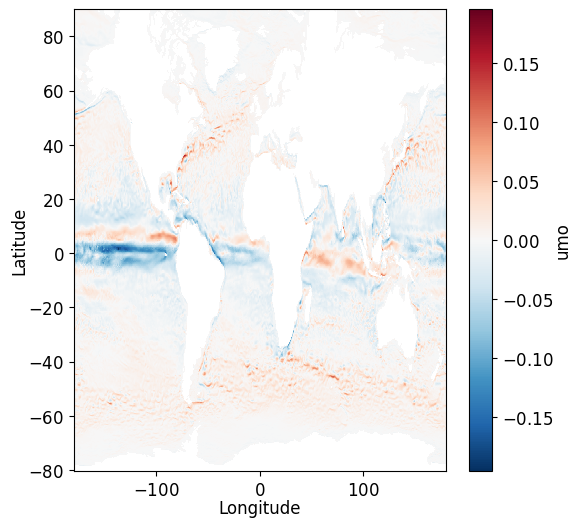

In [36]:
(umo * mks2Sv).plot()
plt.title('')

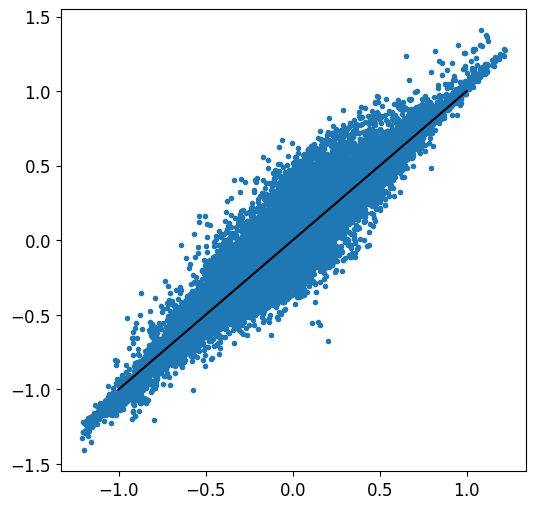

In [41]:
plt.plot(uo.values.ravel(), (umo/dy/1000/dz).values.ravel(),'.')
plt.plot([-1,1],[-1,1],color='k')

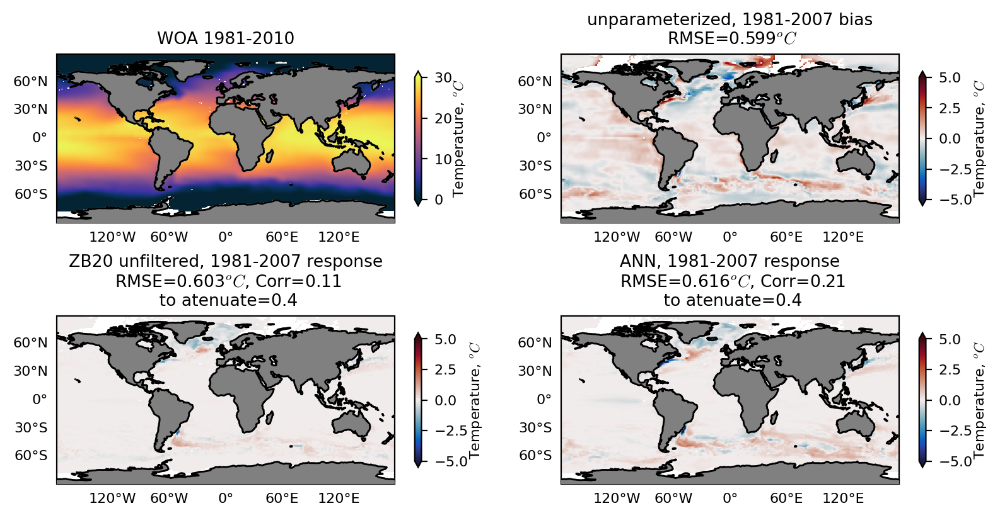

In [4]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], plot_type='response')
plt.savefig('60years/SST_global.pdf')

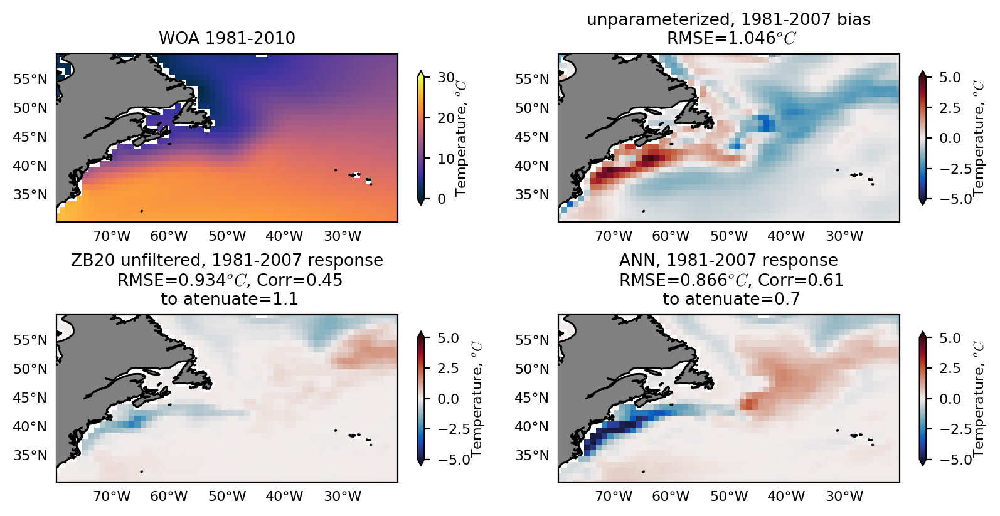

In [4]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], plot_type='response', select=select_Gulf)
plt.savefig('60years/NA.pdf')

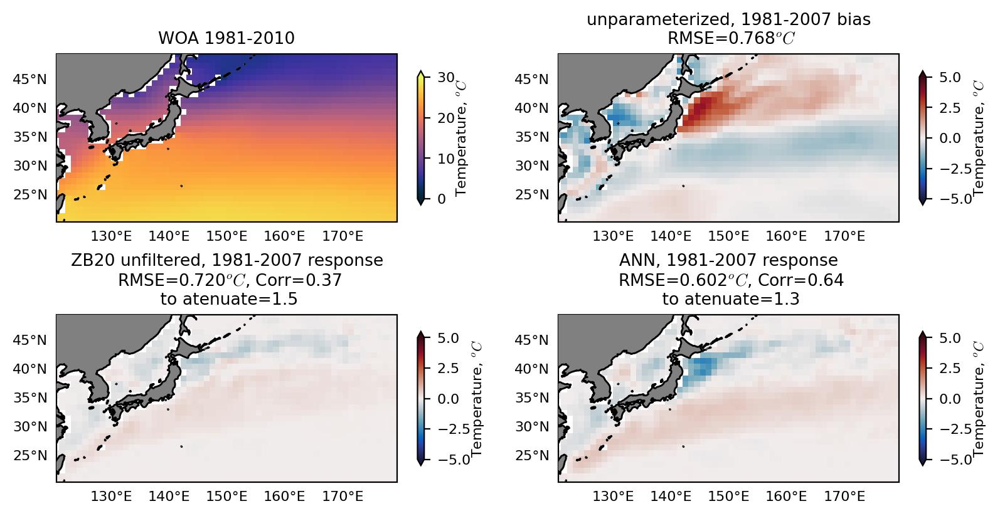

In [8]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], plot_type='response', select=select_Kuroshio)
plt.savefig('60years/NA.pdf')

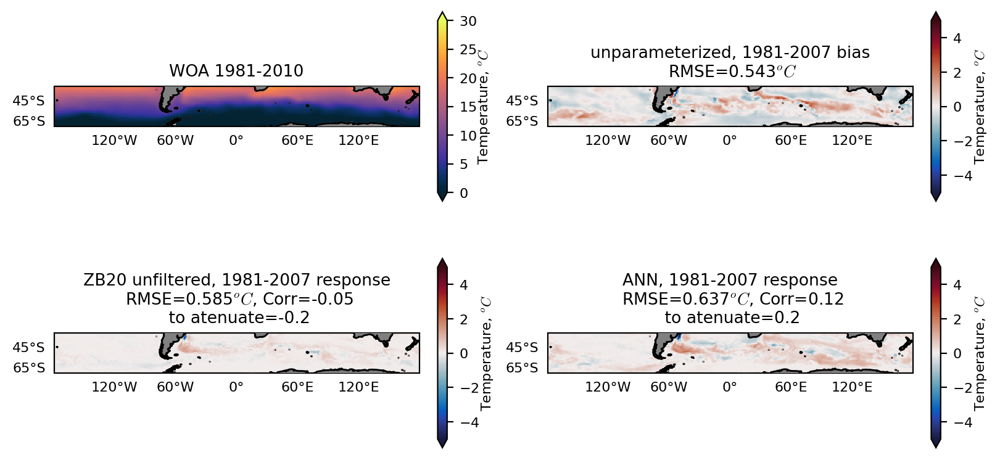

In [5]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], plot_type='response', select=select_SO)
plt.savefig('60years/NA.pdf')

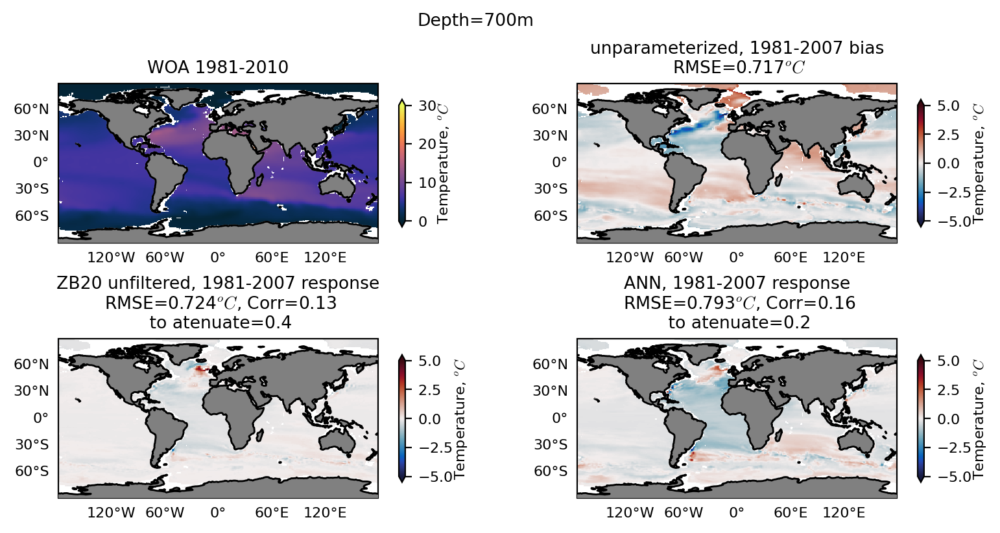

In [6]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], 
             plot_type='response', zl=15)
plt.suptitle('Depth=700m')
plt.savefig('60years/global_700m.pdf')

Text(0.5, 0.98, 'MLD summer')

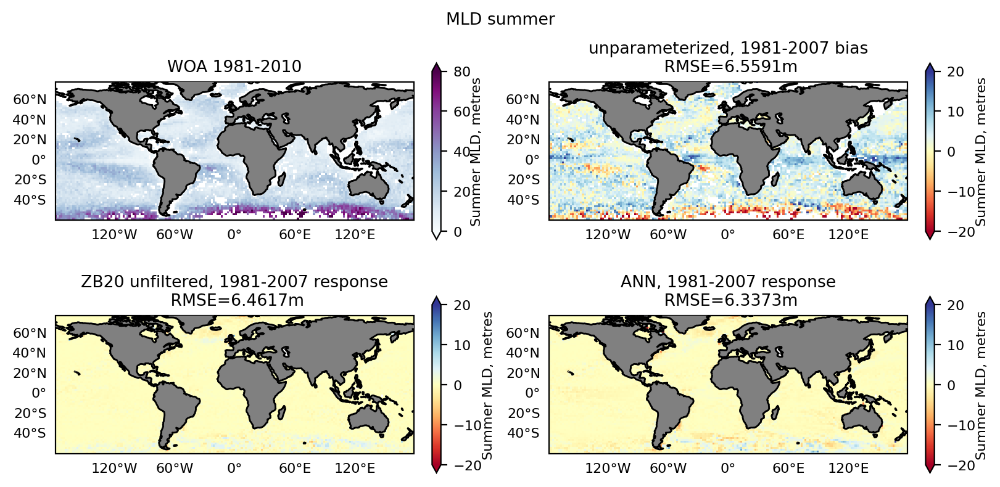

In [3]:
ds.plot_MLD_summer(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], 
             plot_type='response')
plt.suptitle('MLD summer')

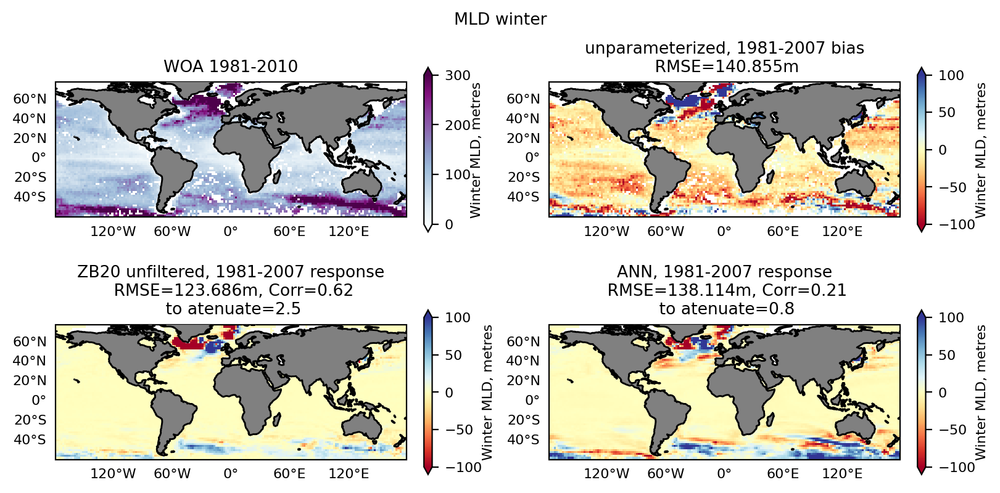

In [6]:
ds.plot_MLD_winter(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], 
             plot_type='response')
plt.suptitle('MLD winter')
plt.savefig('60years/MLD_winter.pdf')

In [ ]:
ds.plot_MLD_winter(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'], 
             plot_type='response')
plt.suptitle('MLD winter')

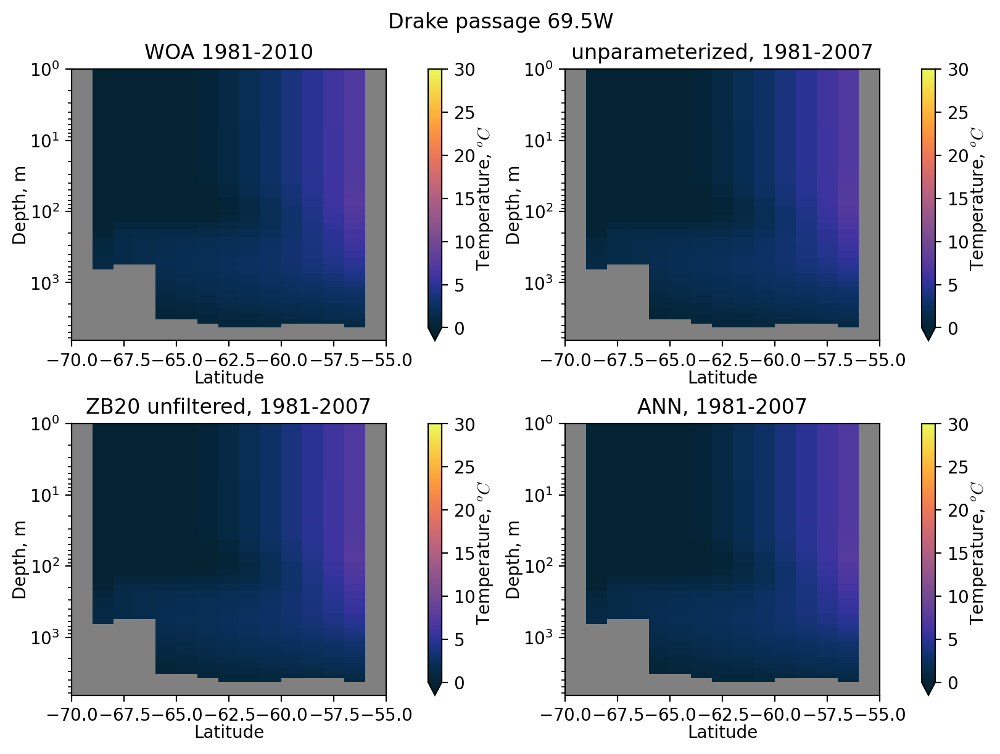

In [9]:
ds.plot_temp_section(['obs', 'unparameterized', 'ZB20', 'ANN'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007', 'ANN, 1981-2007'],
                     plot_type='reseponse')
plt.suptitle('Drake passage 69.5W')
plt.savefig('60years/Drake.pdf')

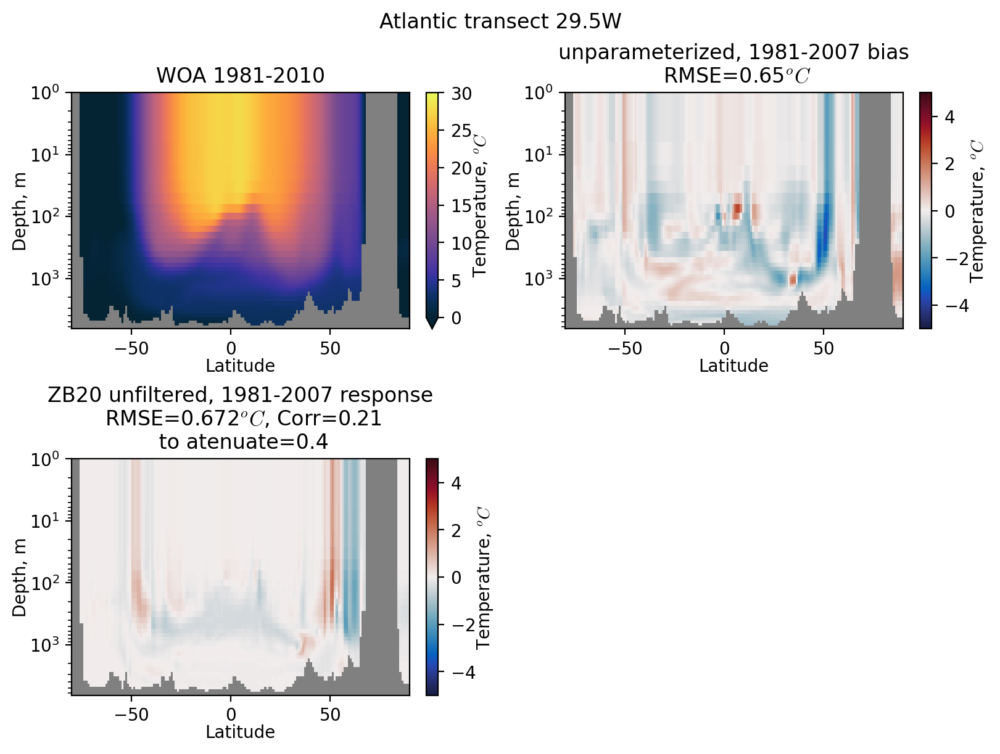

In [64]:
ds.plot_temp_section(['obs', 'unparameterized', 'ZB20'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007'], plot_type='response', select=select_Atlantic_transect)
plt.suptitle('Atlantic transect 29.5W')
plt.savefig('60years/Atlantic.pdf')

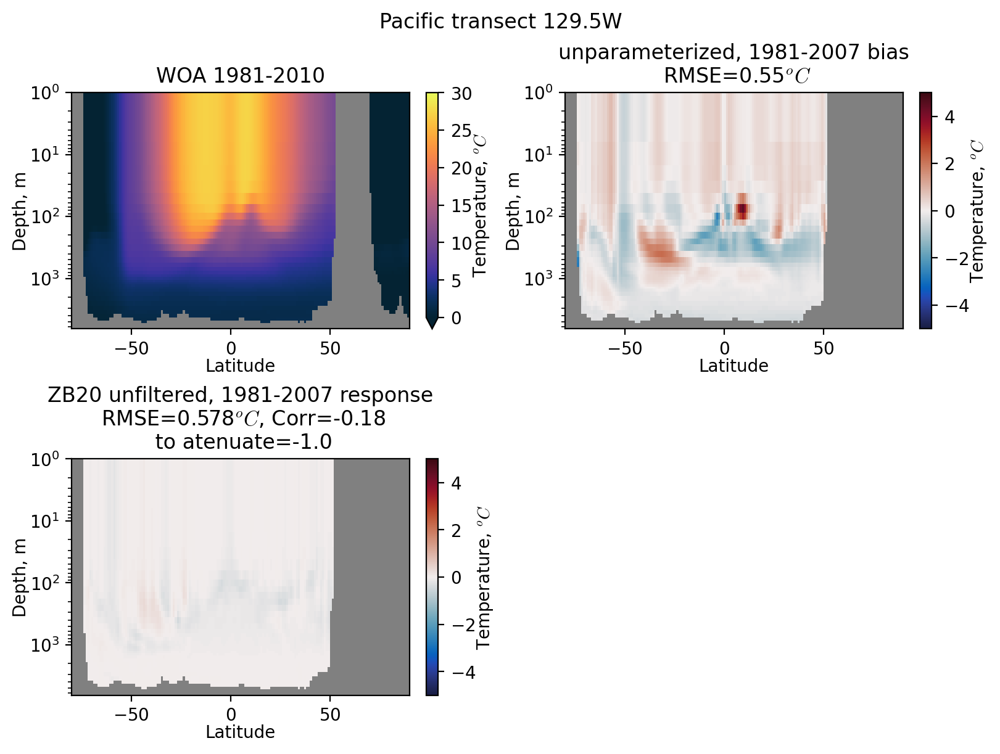

In [65]:
ds.plot_temp_section(['obs', 'unparameterized', 'ZB20'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007'], plot_type='response', select=select_Pacific_transect)
plt.suptitle('Pacific transect 129.5W')
plt.savefig('60years/Pacific.pdf')

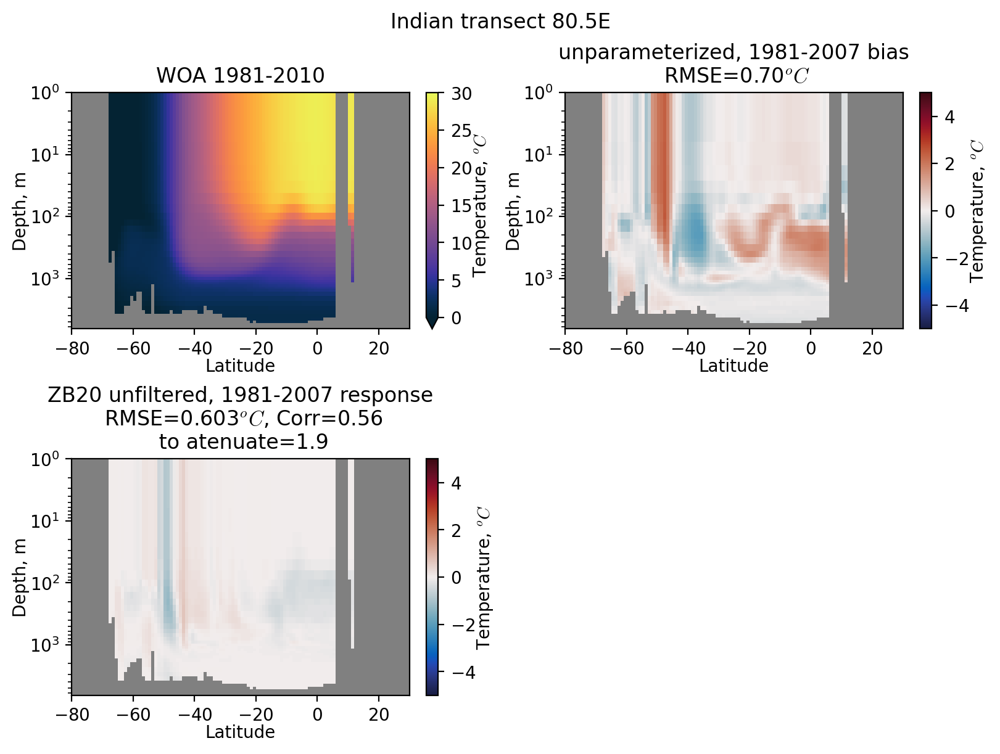

In [66]:
ds.plot_temp_section(['obs', 'unparameterized', 'ZB20'], labels=['WOA 1981-2010', 'unparameterized, 1981-2007', 'ZB20 unfiltered, 1981-2007'], plot_type='response', select=select_Indian_transect)
plt.suptitle('Indian transect 80.5E')
plt.savefig('60years/Indian.pdf')

# MOC

In [39]:
data = xr.open_mfdataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/unparameterized/*ocean_annual_z*', combine='nested', compat='no_conflicts', 
                         concat_dim='time')

In [40]:
dsgrid = xr.open_dataset('../data/ocean_static.nc').drop_vars(['time'])

In [41]:
from xoverturning import calcmoc

In [42]:
amoc_ctrl = calcmoc(data[['umo', 'vmo', 'z_i']], dsgrid=dsgrid, basin='atl-arc').compute()

generating basin codes


In [94]:
data_zb = xr.open_mfdataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/ZB20/*ocean_annual_z*', combine='nested', compat='no_conflicts', concat_dim='time')

In [95]:
amoc_zb = calcmoc(data_zb[['umo', 'vmo', 'z_i']], dsgrid=dsgrid, basin='atl-arc').compute()

generating basin codes


In [96]:
data_ann = xr.open_mfdataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/ANN/*ocean_annual_z*', combine='nested', compat='no_conflicts', concat_dim='time')

In [97]:
amoc_ann = calcmoc(data_ann[['umo', 'vmo', 'z_i']], dsgrid=dsgrid, basin='atl-arc').compute()

generating basin codes


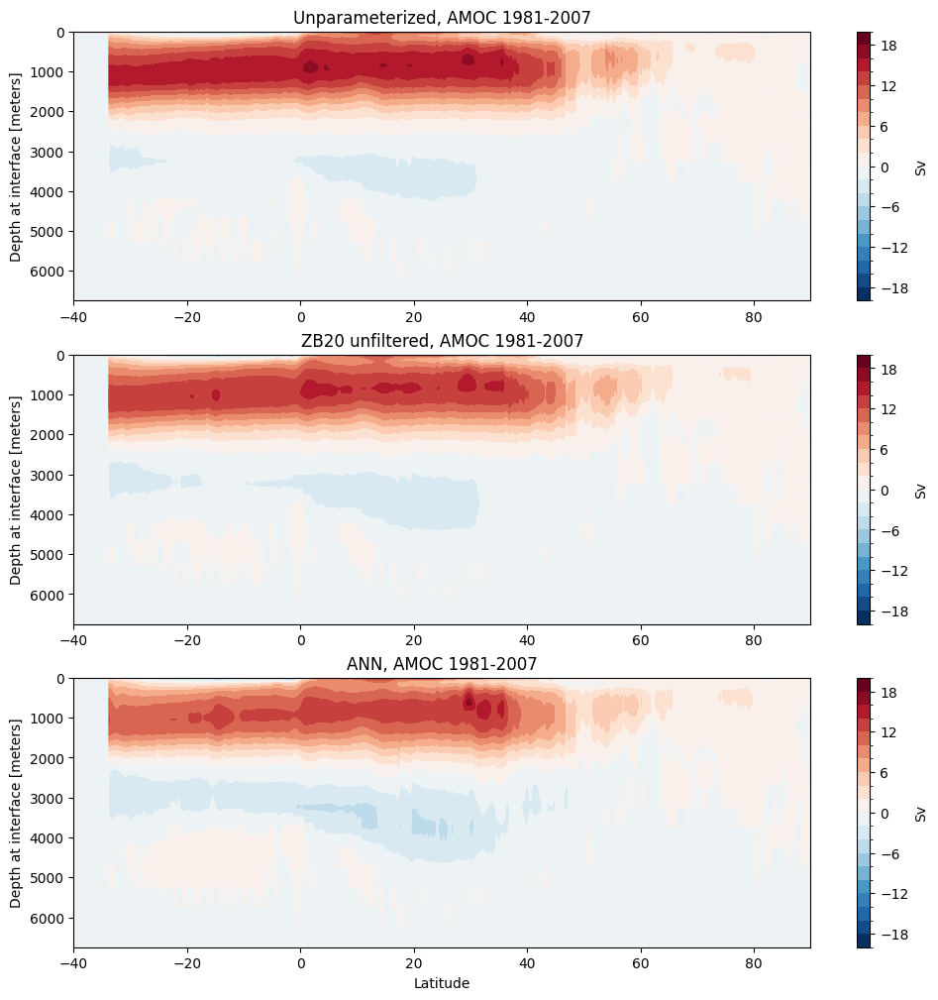

In [98]:
plt.figure(figsize=(12,12))
plt.subplot(3,1,1)
amoc_ctrl.sel(time=slice('1981',None)).mean('time').plot.contourf(levels=np.arange(-20,22,2), cbar_kwargs={'label': 'Sv'})
plt.gca().invert_yaxis()
plt.title('Unparameterized, AMOC 1981-2007')
plt.xlabel('')
plt.xlim([-40,None])

plt.subplot(3,1,2)
amoc_zb.sel(time=slice('1981',None)).mean('time').plot.contourf(levels=np.arange(-20,22,2), cbar_kwargs={'label': 'Sv'})
plt.gca().invert_yaxis()
plt.title('ZB20 unfiltered, AMOC 1981-2007')
plt.xlabel('')
plt.xlim([-40,None])

plt.subplot(3,1,3)
amoc_ann.sel(time=slice('1981',None)).mean('time').plot.contourf(levels=np.arange(-20,22,2), cbar_kwargs={'label': 'Sv'})
plt.gca().invert_yaxis()
plt.title('ANN, AMOC 1981-2007')
plt.xlabel('Latitude')
plt.xlim([-40,None])

plt.savefig('60years/AMOC.pdf')

In [99]:
obs = xr.open_dataset('../data/AMOC_26p5_max_RAPID_annual_2004-2021.nc')

In [100]:
obs_amoc_max = obs.AMOC.drop_vars(['time'])
ctrl_amoc_max = amoc_ctrl.interp(yq=26.5).max('z_i').sel(time=slice('1978',None)).drop_vars(['time'])
zb_amoc_max = amoc_zb.interp(yq=26.5).max('z_i').sel(time=slice('1978',None)).drop_vars(['time'])
ann_amoc_max = amoc_ann.interp(yq=26.5).max('z_i').sel(time=slice('1978',None)).drop_vars(['time'])

In [101]:
time_obs = np.arange(2004,2022)
time_ctrl = np.arange(1978, 2008)

obs_amoc_max['time'] = time_obs
ctrl_amoc_max['time'] = time_ctrl
zb_amoc_max['time'] = time_ctrl
ann_amoc_max['time'] = time_ctrl

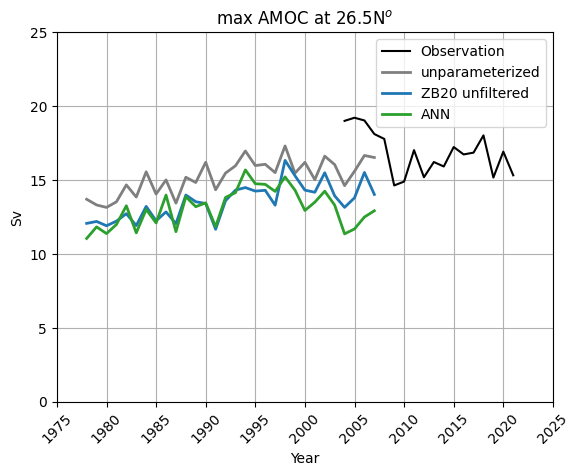

In [102]:
obs_amoc_max.plot(color='k', label='Observation')
ctrl_amoc_max.plot(color='tab:gray', lw=2, label='unparameterized')
zb_amoc_max.plot(color='tab:blue', lw=2, label='ZB20 unfiltered')
ann_amoc_max.plot(color='tab:green', lw=2, label='ANN')
plt.title('max AMOC at 26.5N$^o$')
plt.legend()
plt.xticks([1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015, 2020, 2025], [1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015, 2020, 2025], rotation=45)
plt.xlabel('Year')
plt.ylabel('Sv')
plt.xlim([1975, 2025])
plt.ylim([0,25])
plt.grid()
plt.savefig('max_AMOC.pdf')

# SO MOC

In [153]:
moc_ctrl = calcmoc(data[['umo', 'vmo', 'z_i']], dsgrid=dsgrid).compute()

generating basin codes


In [166]:
moc_zb = calcmoc(data_zb[['umo', 'vmo', 'z_i']], dsgrid=dsgrid).compute()

generating basin codes


In [167]:
moc_ann = calcmoc(data_ann[['umo', 'vmo', 'z_i']], dsgrid=dsgrid).compute()

generating basin codes


[-60.         -53.68421053 -47.36842105 -41.05263158 -34.73684211
 -28.42105263 -22.10526316 -15.78947368  -9.47368421  -3.15789474
   3.15789474   9.47368421  15.78947368  22.10526316  28.42105263
  34.73684211  41.05263158  47.36842105  53.68421053  60.        ]


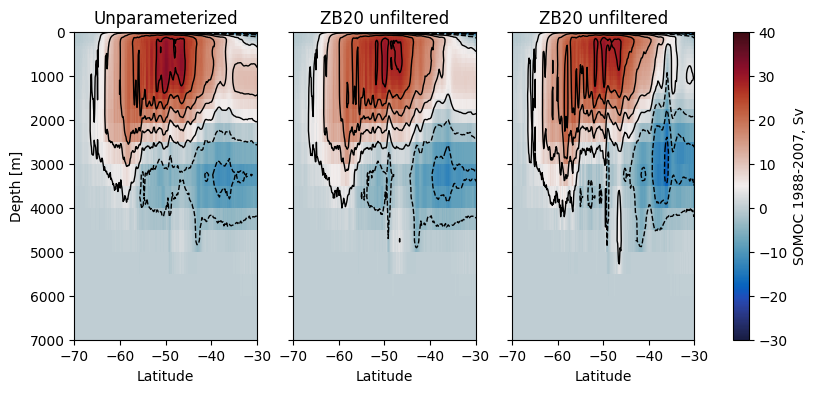

In [198]:
cmap = cmocean.cm.balance
cmap.set_bad('gray')

fig, axes = plt.subplots(1,3,figsize=(10,4), sharey = True)

plt.sca(axes[0])
moc_ctrl.sel(time=slice('1988',None)).mean('time').plot.pcolormesh(vmin=-30, vmax=40, cmap=cmap, add_colorbar=False, rasterized=True)
contour_obj = moc_ctrl.sel(time=slice('1988',None)).mean('time').plot.contour(levels=np.linspace(-60,60,20), colors='k', linewidths=1)
plt.gca().invert_yaxis()
plt.title('Unparameterized')
plt.xlabel('Latitude')
plt.ylabel('Depth [m]')
plt.xlim([-70,-30])

used_levels = contour_obj.levels
print(used_levels)

plt.sca(axes[1])
moc_zb.sel(time=slice('1988',None)).mean('time').plot.pcolormesh(vmin=-30, vmax=40, cmap=cmap, add_colorbar=False, rasterized=True)
moc_zb.sel(time=slice('1988',None)).mean('time').plot.contour(levels=used_levels, colors='k', linewidths=1)
plt.gca().invert_yaxis()
plt.title('ZB20 unfiltered')
plt.xlabel('Latitude')
plt.ylabel('')
plt.xlim([-70,-30])

plt.sca(axes[2])
im = moc_ann.sel(time=slice('1988',None)).mean('time').plot.pcolormesh(vmin=-30, vmax=40, cmap=cmap, add_colorbar=False, rasterized=True)
moc_ann.sel(time=slice('1988',None)).mean('time').plot.contour(levels=used_levels, colors='k', linewidths=1)
plt.gca().invert_yaxis()
plt.title('ZB20 unfiltered')
plt.xlabel('Latitude')
plt.ylabel('')
plt.xlim([-70,-30])

plt.colorbar(im, ax=axes, label='SOMOC 1988-2007, Sv')

plt.savefig('60years/SOMOC.pdf', dpi=200)

# Drake passage 

In [141]:
def compute_Drake_transport(data):
    mks2Sv = 1.0/1e9# * 1000. / 1035. # Magic number from OM4 notebook. Converts kg / s to Sv; 1035. is reference density

    selected_umo = data.umo.sel(xq=-70, method='nearest').sel(yh=slice(-71,-54.5)).sel(time=slice('1978',None))

    return selected_umo * mks2Sv

In [142]:
Drake_ctrl = compute_Drake_transport(data).compute()

In [143]:
Drake_zb = compute_Drake_transport(data_zb).compute()

In [144]:
Drake_ann = compute_Drake_transport(data_ann).compute()

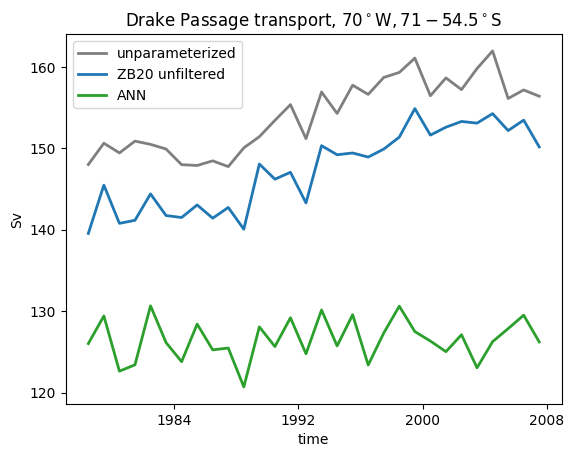

In [145]:
Drake_ctrl.sum(['z_l','yh']).plot(color='tab:gray', lw=2, label='unparameterized')
Drake_zb.sum(['z_l','yh']).plot(color='tab:blue', lw=2, label='ZB20 unfiltered')
Drake_ann.sum(['z_l','yh']).plot(color='tab:green', lw=2, label='ANN')
plt.title('Drake Passage transport, $70^\circ\mathrm{W}, 71-54.5^\circ \mathrm{S}$')
plt.ylabel('Sv')
plt.legend()

In [4]:
def compute_Drake_section(data):
    selected_uo = data.uo.sel(xq=-70, method='nearest').sel(yh=slice(-71,-54.5)).sel(time=slice('1981',None)).mean('time')

    return selected_uo

In [11]:
def compute_zonal_section(data):
    selected_uo = data.uo.mean('xq').sel(yh=slice(-65,-30)).sel(time=slice('1981',None)).mean('time')

    return selected_uo

In [6]:
Drake2d_ctrl = compute_Drake_section(ds['unparameterized'].ocean_annual_z).compute()

In [7]:
Drake2d_ann = compute_Drake_section(ds['ANN'].ocean_annual_z).compute()

In [12]:
zonal2d_ctrl = compute_zonal_section(ds['unparameterized'].ocean_annual_z).compute()

In [13]:
zonal2d_ann = compute_zonal_section(ds['ANN'].ocean_annual_z).compute()

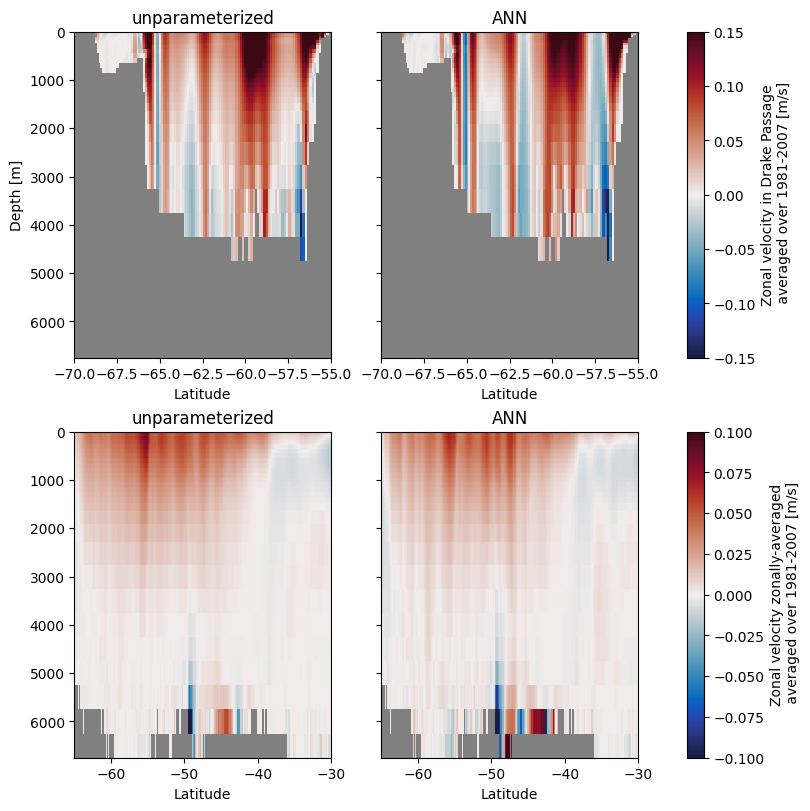

In [42]:
import cmocean
import matplotlib as mpl
fig, axes = plt.subplots(2, 2, figsize=(8, 8), sharey=True, constrained_layout=True)

cmap = cmocean.cm.balance
cmap.set_bad('gray')

plt.sca(axes[0][0])
Drake2d_ctrl.plot.pcolormesh(vmin = -0.15, cmap=cmap, add_colorbar=False, rasterized=True)
plt.gca().invert_yaxis()
plt.title('unparameterized')
plt.ylabel('Depth [m]')
plt.xlabel('Latitude')
plt.xlim([-70,-55])

plt.sca(axes[0][1])
im1 = Drake2d_ann.plot.pcolormesh(vmin = -0.15, cmap=cmap, add_colorbar=False, rasterized=True)
plt.gca().invert_yaxis()
plt.title('ANN')
plt.ylabel('')
plt.xlabel('Latitude')
plt.ylim([4500,0])
plt.xlim([-70,-55])

plt.sca(axes[1][0])
zonal2d_ctrl.plot.pcolormesh(vmin=-0.1,cmap=cmap, add_colorbar=False, rasterized=True)
plt.gca().invert_yaxis()
plt.title('unparameterized')
plt.ylabel('')
plt.xlabel('Latitude')
plt.ylim([None,0])
plt.xlim([-65,-30])

plt.sca(axes[1][1])
im2 = zonal2d_ann.plot.pcolormesh(vmin=-0.1,cmap=cmap, add_colorbar=False, rasterized=True)
plt.gca().invert_yaxis()
plt.title('ANN')
plt.ylabel('')
plt.xlabel('Latitude')
plt.ylim([None,0])
plt.xlim([-65,-30])

plt.colorbar(im1, ax=axes[0][:], label='Zonal velocity in Drake Passage\n averaged over 1981-2007 [m/s]')
plt.colorbar(im2, ax=axes[1][:], label='Zonal velocity zonally-averaged\n averaged over 1981-2007 [m/s]')

#plt.tight_layout()
#plt.savefig('60years/zonal-Drake.pdf', dpi=200)

In [36]:
dS = ds['unparameterized'].param.dyCu.isel(xq=0) * ds['unparameterized'].dz
(Drake2d_ctrl * dS).sum() - (Drake2d_ann * dS).sum()

<xarray.DataArray ()> Size: 8B
array(27759666.24143562)

In [37]:
(zonal2d_ctrl * dS).sum() - (zonal2d_ann * dS).sum()

<xarray.DataArray ()> Size: 8B
array(17805454.17910531)
Coordinates:
    xq       float64 8B -179.8

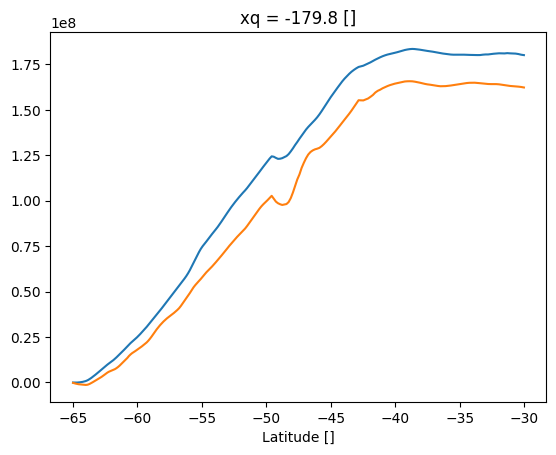

In [41]:
(zonal2d_ctrl * dS).sum('zl').cumsum('yh').plot()
(zonal2d_ann * dS).sum('zl').cumsum('yh').plot()

In [267]:
import gsw

In [269]:
def compute_N2(data):
    sel = lambda x: x.sel(xh=-70,method='nearest').sel(yh=slice(-70,-55)).isel(time=-1)
    pressure = sel(data.so)*0
    pressure = pressure + pressure.z_l
    so = sel(data.so)
    thetao = sel(data.thetao)
    N2 = gsw.Nsquared(so, thetao, p=pressure, axis=0)[0]

    N2 = xr.DataArray(N2, dims=['z_l', 'yh'])
    N2['yh'] = so.yh
    N2['z_l'] = so['z_l'][1:]
    return N2

In [276]:
N2_ctrl = compute_N2(data)

N2_zb = compute_N2(data_zb)

N2_ann = compute_N2(data_ann)

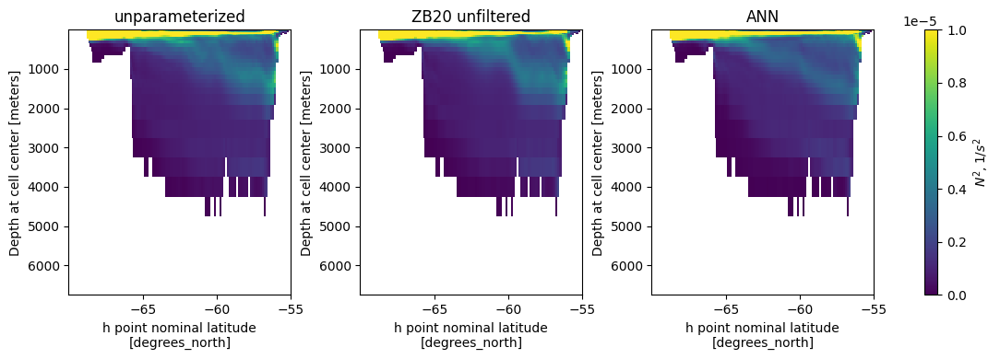

In [285]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
N2_ctrl.plot(vmin=0, vmax=1e-5, add_colorbar=False)
plt.gca().invert_yaxis()
plt.title('unparameterized')

plt.subplot(1,3,2)
N2_zb.plot(vmin=0, vmax=1e-5, add_colorbar=False)
plt.gca().invert_yaxis()
plt.title('ZB20 unfiltered')

plt.subplot(1,3,3)
im = N2_ann.plot(vmin=0, vmax=1e-5, add_colorbar=False)
plt.gca().invert_yaxis()
plt.title('ANN')

plt.tight_layout()
plt.colorbar(im, ax=plt.gcf().axes, label='$N^2, 1/s^2$')
p

Text(0.5, 1.0, '60S$^\\circ$')

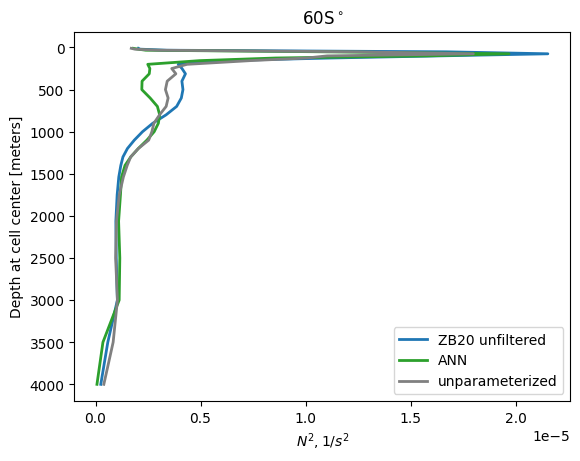

In [299]:
N2_zb.sel(yh=-60, method='nearest').plot(color='tab:blue', y='z_l', lw=2, label='ZB20 unfiltered')
N2_ann.sel(yh=-60, method='nearest').plot(color='tab:green', y='z_l', lw=2, label='ANN')
N2_ctrl.sel(yh=-60, method='nearest').plot(color='gray', y='z_l', lw=2, label='unparameterized')
plt.gca().invert_yaxis()
plt.xlabel('$N^2, 1/s^2$')
plt.legend()
plt.title('60S$^\circ$')

# Circulation

item not found


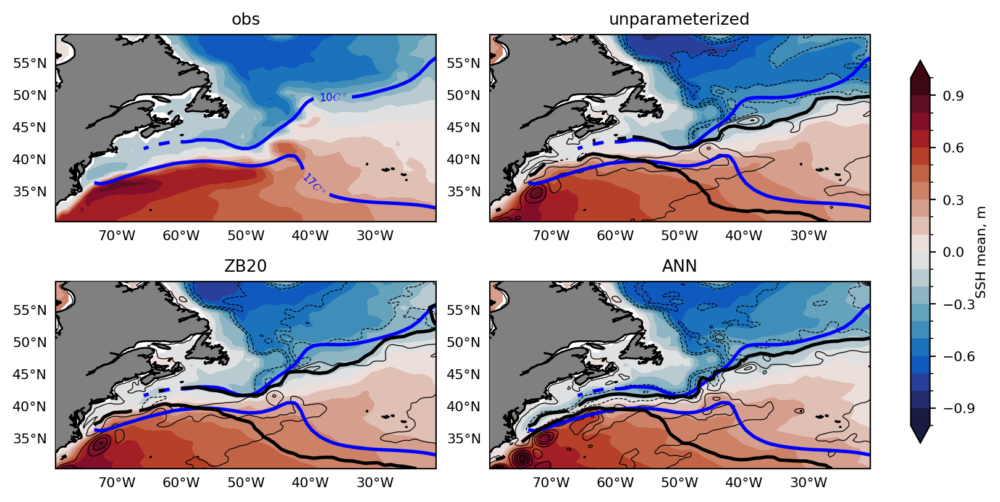

In [57]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_Gulf, projection='2D', plot_type='default', overlay_psi=True, isotherm_17=True)

item not found


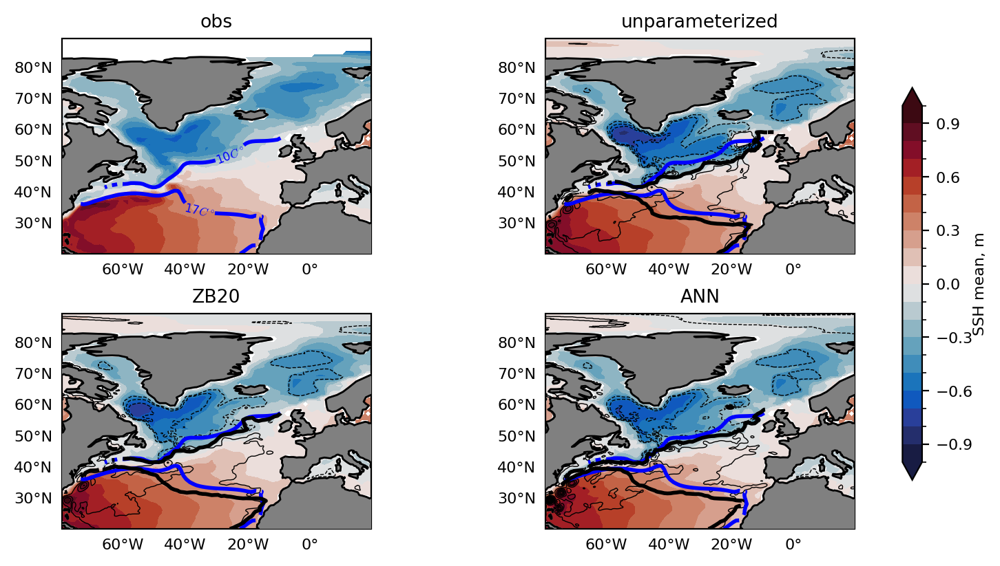

In [54]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Jenny, projection='2D', plot_type='default', overlay_psi=True, isotherm_17=True)

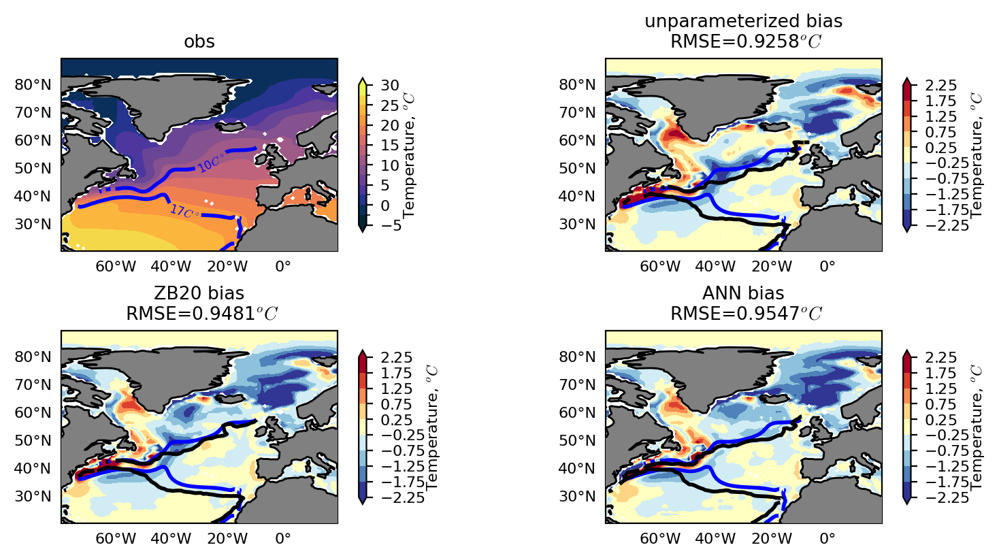

In [55]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Jenny, projection='2D', plot_type='bias', overlay_psi=False, isotherm_17=True)

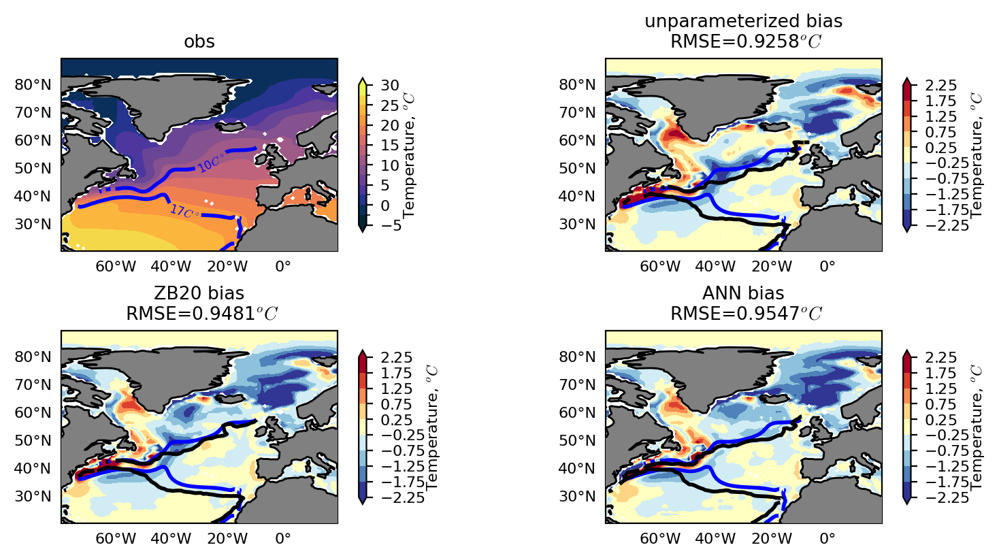

In [56]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Jenny, projection='2D', plot_type='bias', overlay_psi=False, isotherm_17=True)

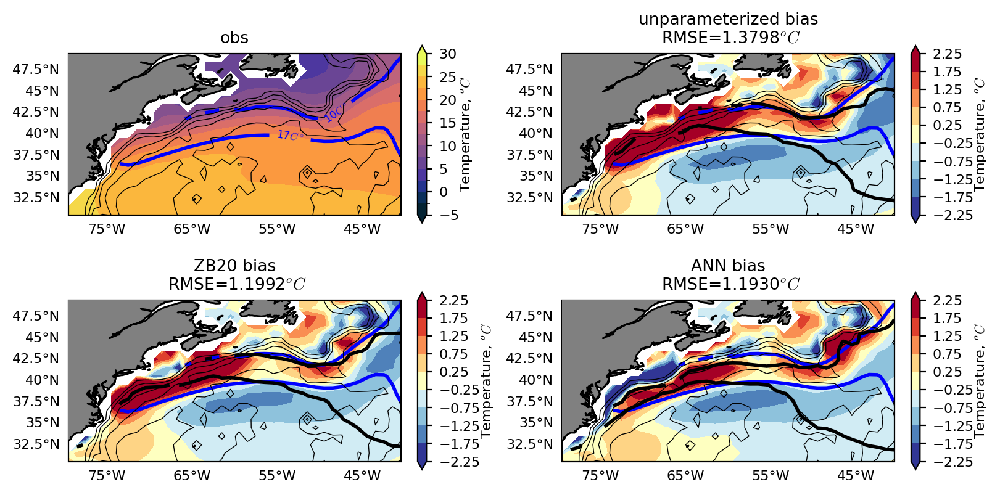

In [95]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_small, projection='2D', plot_type='bias', 
             overlay_depth=True, isotherm_17=True, gridlines=False)

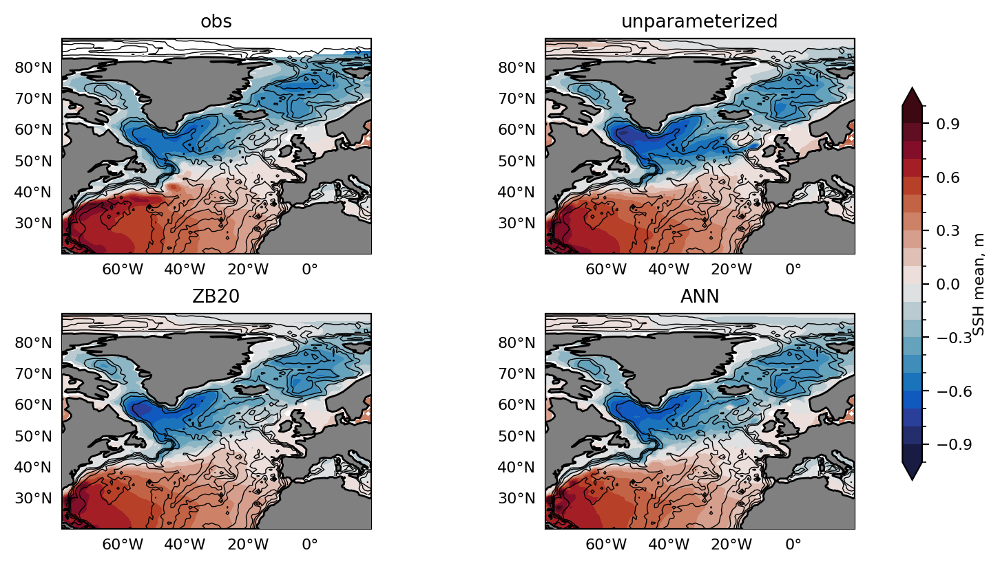

In [94]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Jenny, projection='2D', plot_type='default', overlay_depth=True)

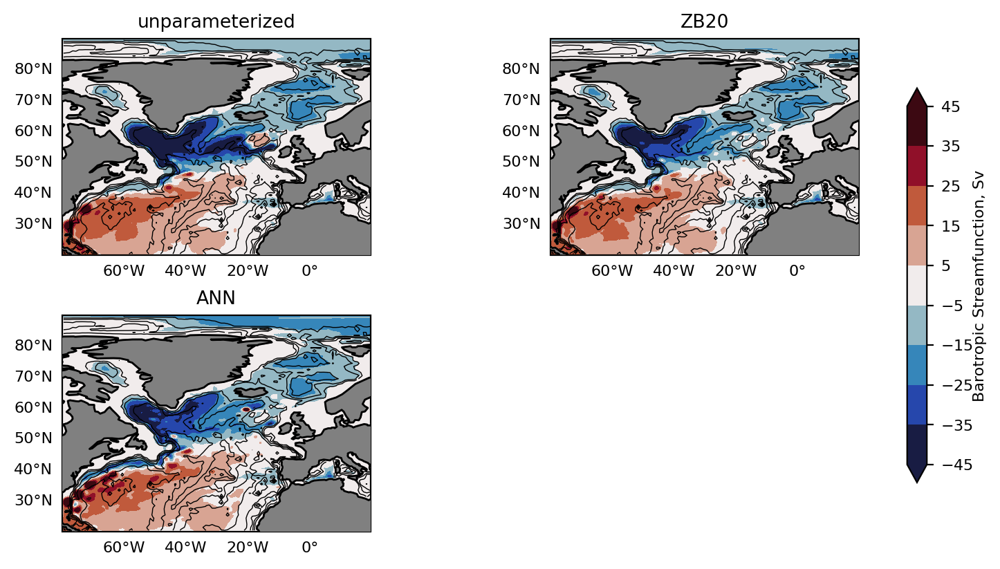

In [93]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN'], select=select_NA_Jenny, projection='2D', plot_type='default', overlay_depth=True)

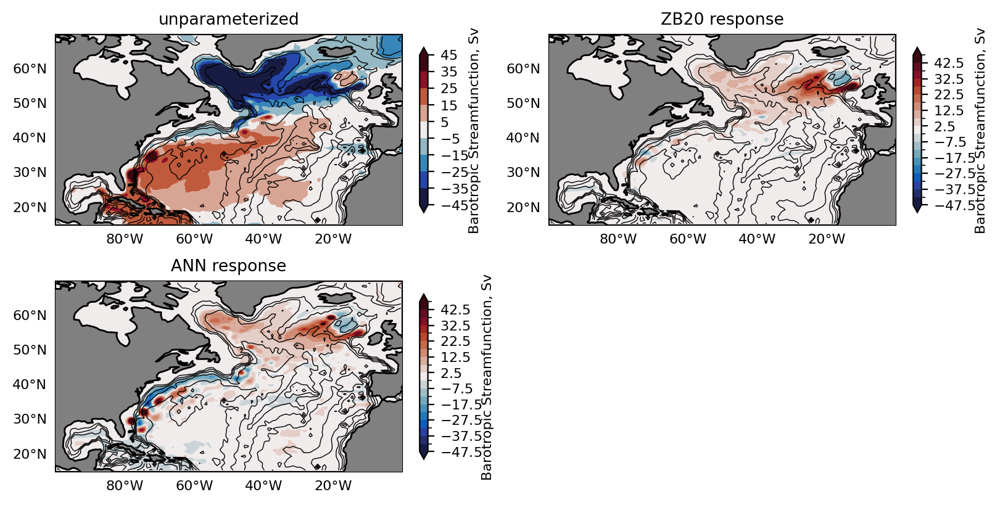

In [100]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN'], select=select_Double_Gyre, projection='2D', plot_type='response', overlay_depth=True)

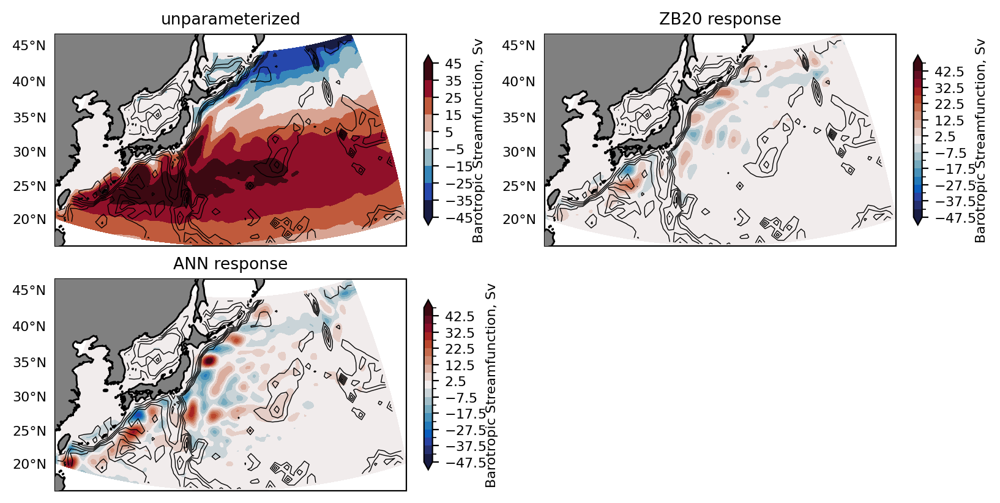

In [181]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN'], select=select_Kuroshio, projection='3D', plot_type='response', overlay_depth=True)

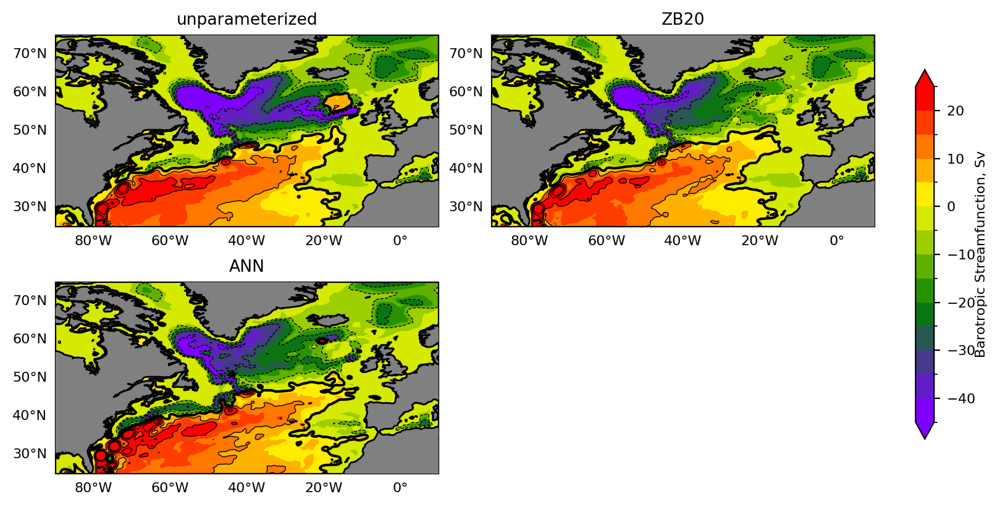

In [37]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN'], contour_lines=True, select=select_NA_Marzocchi)

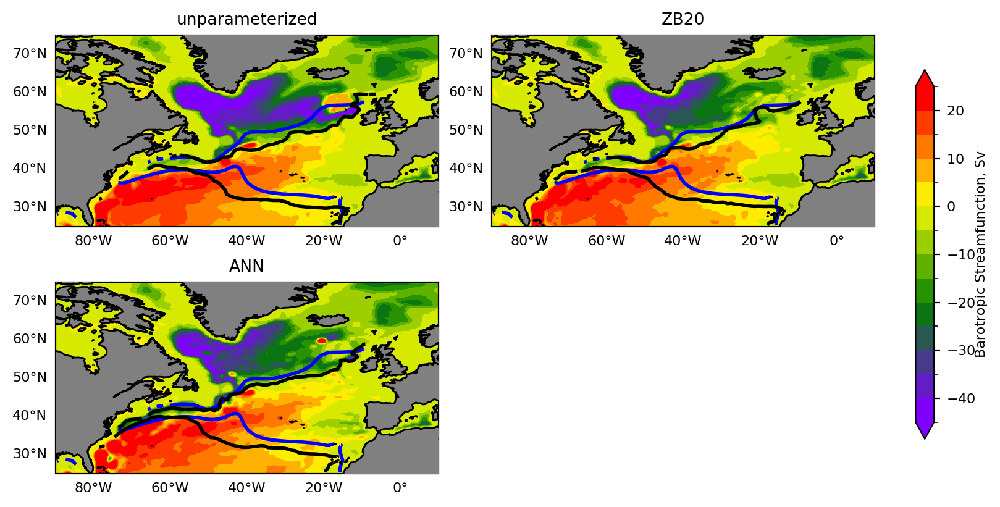

In [40]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN'], contour_lines=False, select=select_NA_Marzocchi, isotherm_17=True)

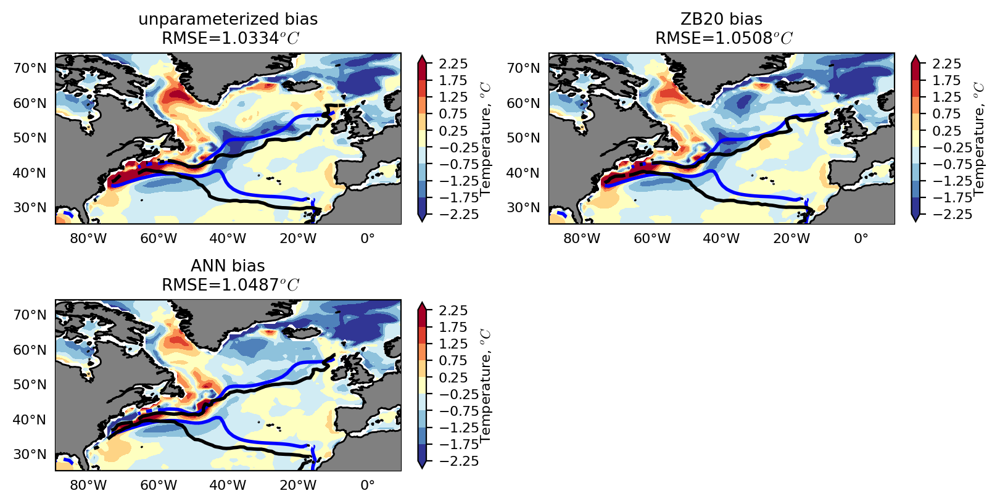

In [42]:
ds.plot_temp(['unparameterized', 'ZB20', 'ANN'], contour_lines=False, select=select_NA_Marzocchi, isotherm_17=True, plot_type='bias')

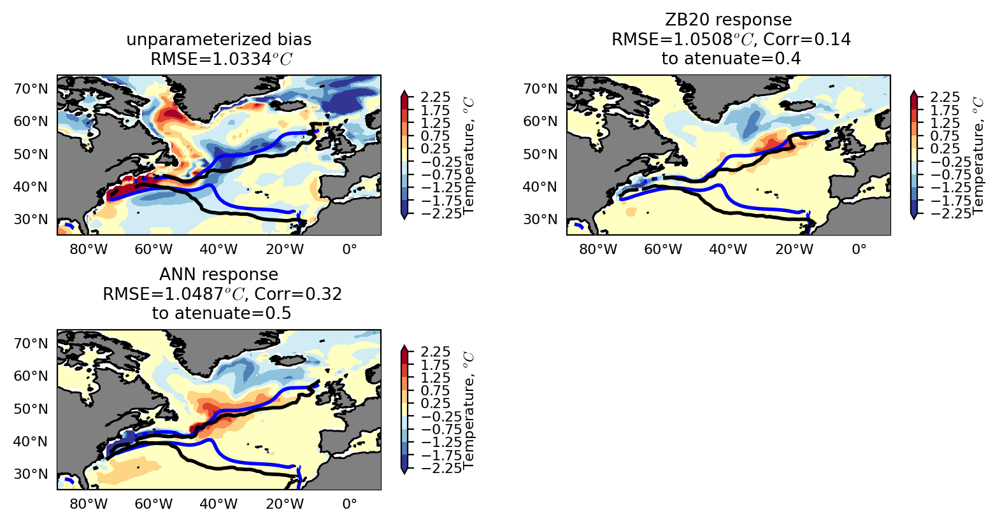

In [43]:
ds.plot_temp(['unparameterized', 'ZB20', 'ANN'], contour_lines=False, select=select_NA_Marzocchi, isotherm_17=True, plot_type='response')

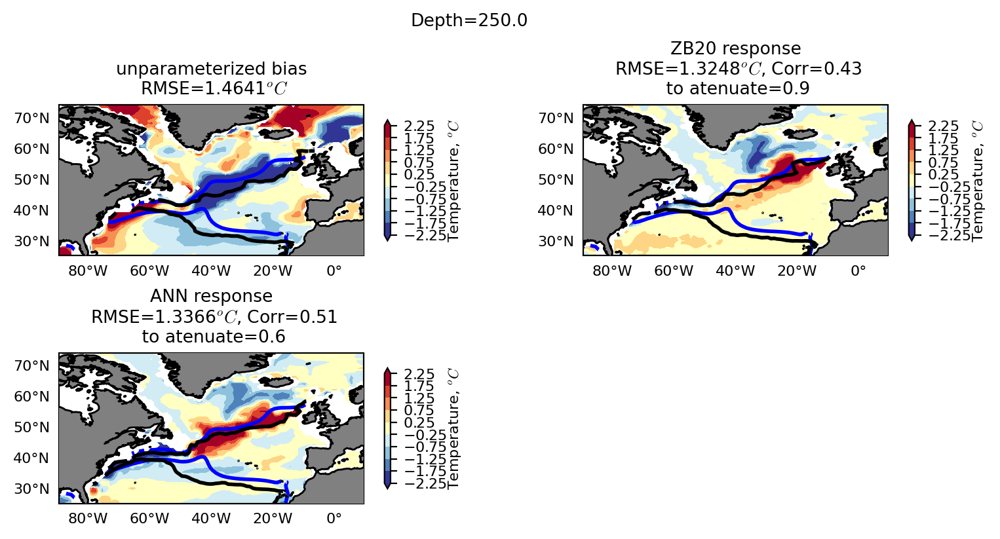

In [44]:
ds.plot_temp(['unparameterized', 'ZB20', 'ANN'], contour_lines=False, select=select_NA_Marzocchi, isotherm_17=True, plot_type='response', zl=10)

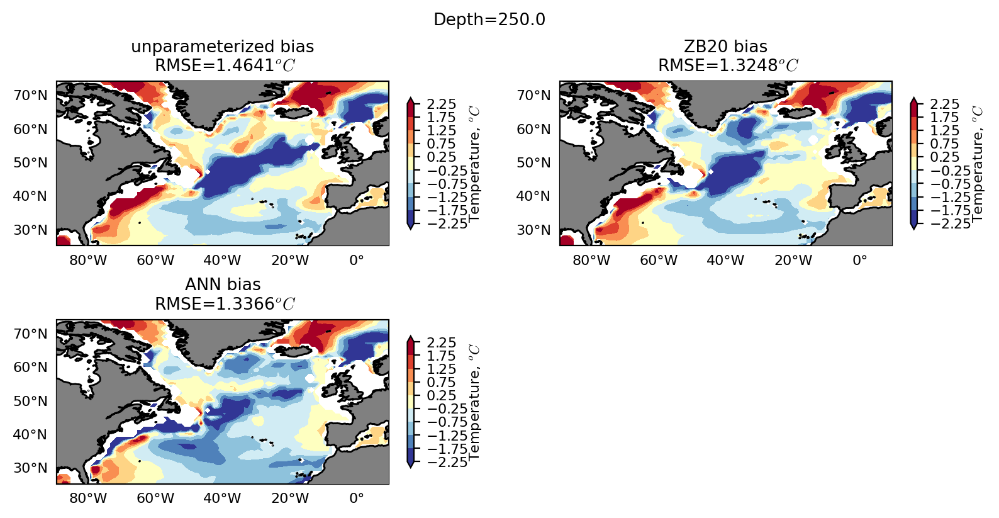

In [46]:
ds.plot_temp(['unparameterized', 'ZB20', 'ANN'], contour_lines=False, select=select_NA_Marzocchi, isotherm_17=False, plot_type='bias', zl=10)

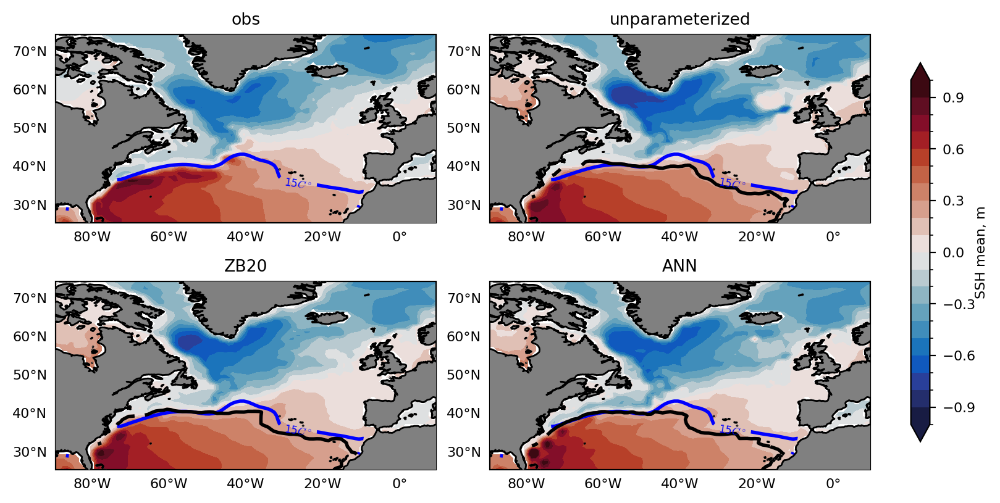

In [71]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Marzocchi, overlay_psi=False, isotherm_17=False, isotherm_15=True, overlay_depth=False)

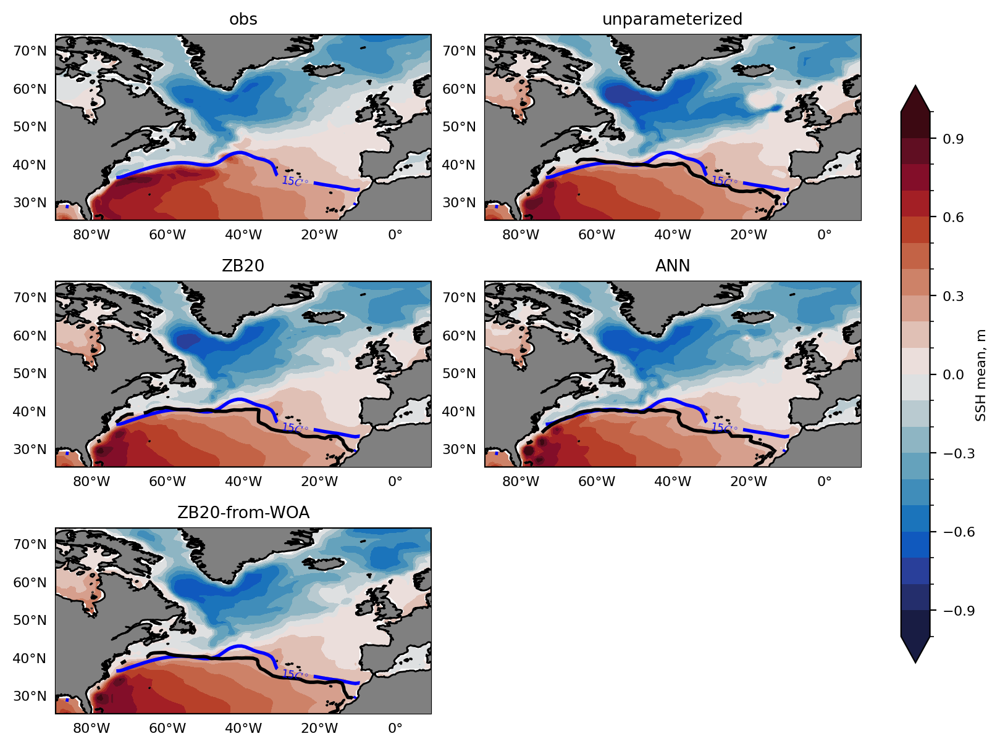

In [133]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20', 'ANN', 'ZB20-from-WOA'], select=select_NA_Marzocchi, overlay_psi=False, isotherm_17=False, isotherm_15=True, overlay_depth=False)

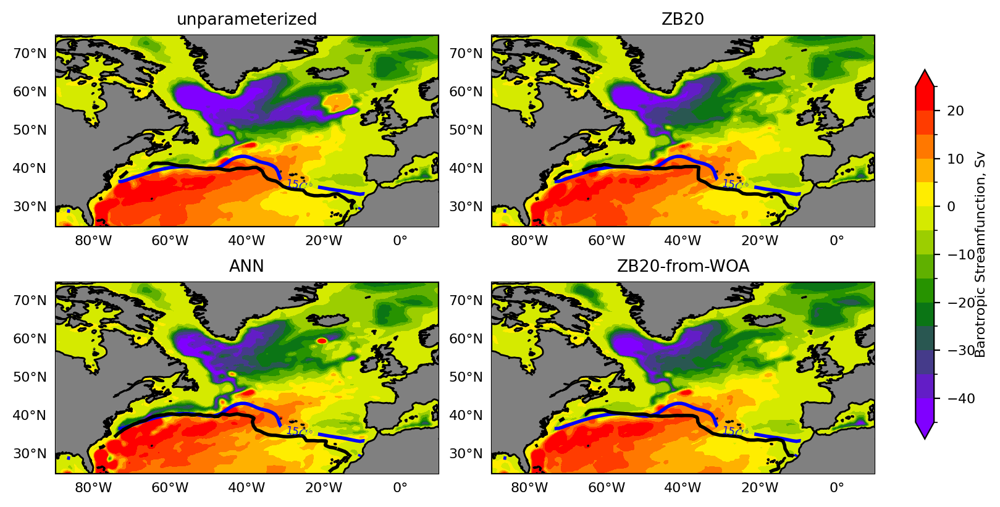

In [135]:
ds.plot_psi(['unparameterized', 'ZB20', 'ANN', 'ZB20-from-WOA'], select=select_NA_Marzocchi, overlay_psi=False, isotherm_17=False, isotherm_15=True, overlay_depth=False)

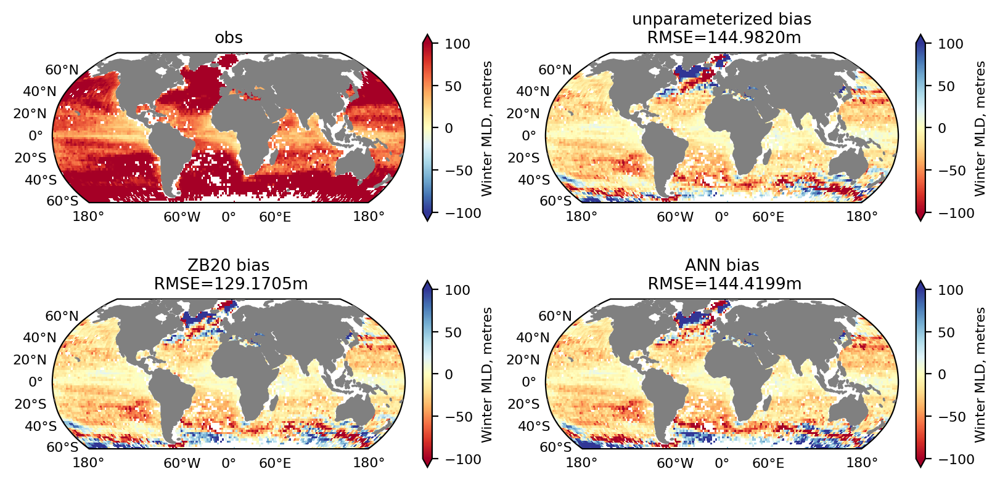

In [191]:
ds.plot_MLD_winter(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_globe, projection='3D', plot_type='bias', vmax=100)

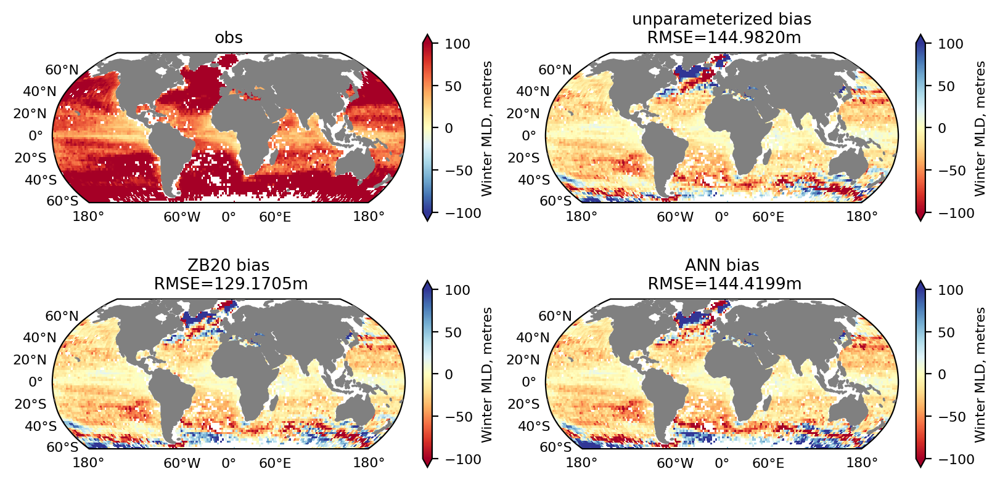

In [193]:
ds.plot_MLD_winter(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_globe, projection='3D', plot_type='bias', vmax=100)

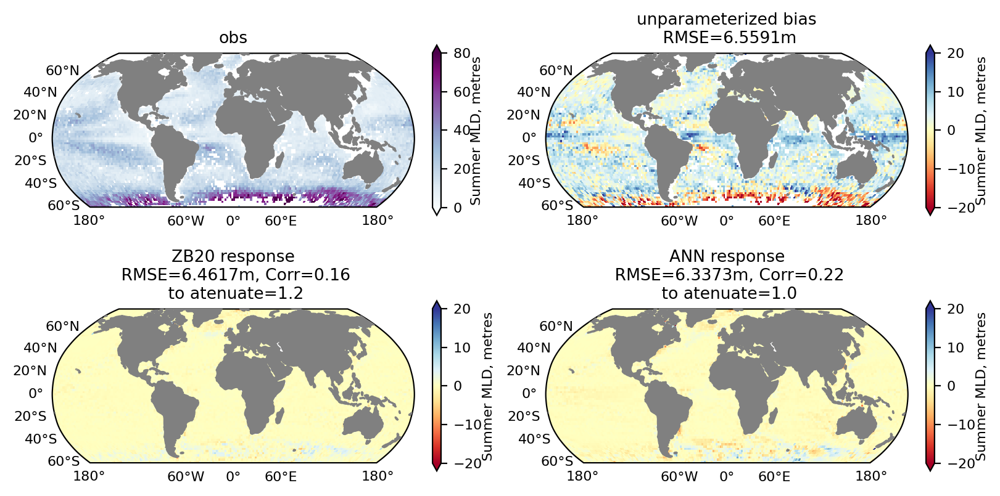

In [190]:
ds.plot_MLD_summer(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_globe, projection='3D', plot_type='response')

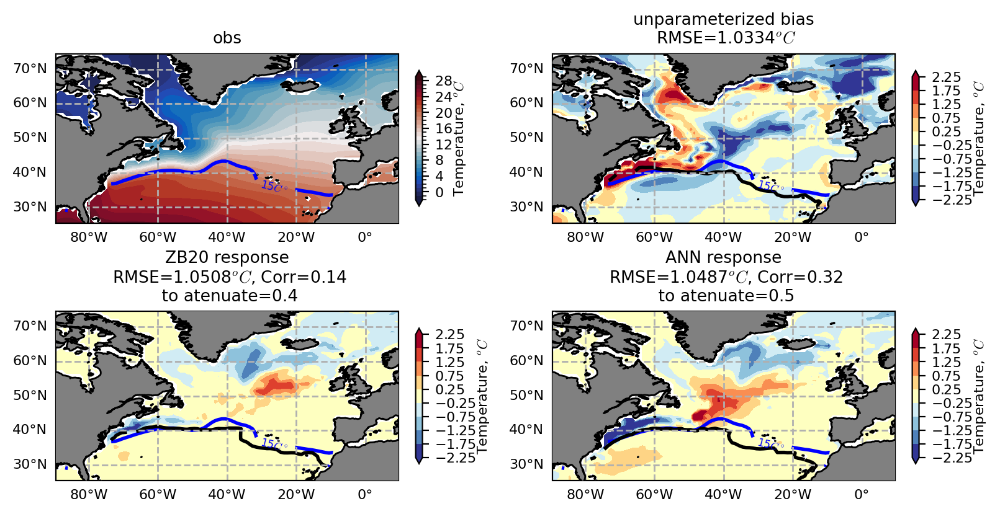

In [65]:
ds.plot_temp(['obs', 'unparameterized', 'ZB20', 'ANN'], select=select_NA_Marzocchi, overlay_psi=False, isotherm_17=False, isotherm_15=True, overlay_depth=False, plot_type='response', gridlines=True)

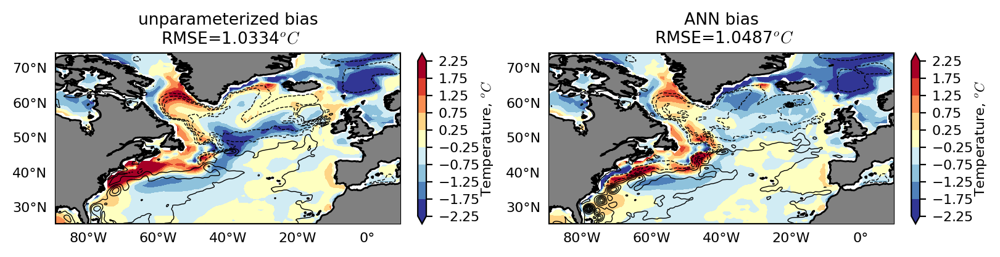

In [145]:
ds.plot_temp(['unparameterized', 'ANN'], select=select_NA_Marzocchi, overlay_psi=True, plot_type='bias')

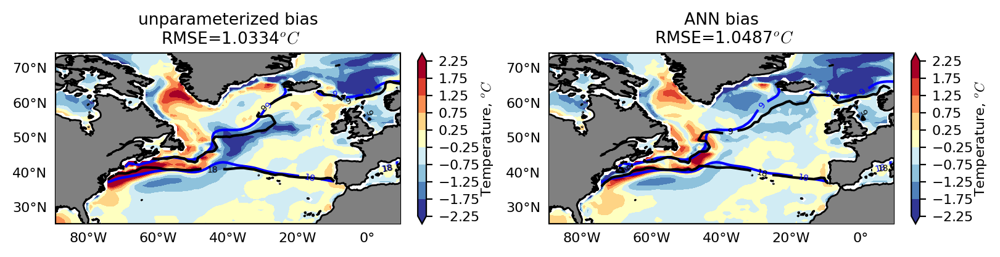

In [144]:
ds.plot_temp(['unparameterized', 'ANN'], select=select_NA_Marzocchi, overlay_psi=False, plot_type='bias', contours_SST=True)

# AMOC? 

# Computing AMOC using xoverturning

In [41]:
data = xr.open_mfdataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/unparameterized/*ocean_annual_z*', combine='nested', compat='no_conflicts', 
                         concat_dim='time')

In [42]:
dsgrid = xr.open_dataset('../data/ocean_static.nc').drop_vars(['time'])

In [43]:
from xoverturning import calcmoc

In [44]:
_data = data[['umo', 'vmo', 'z_i']]
_data['umo'] = _data['umo'] * 0
amoc_ctrl = calcmoc(_data, dsgrid=dsgrid, basin='atl-arc', rho0=1000.).compute()

generating basin codes


(15.0, 65.0)

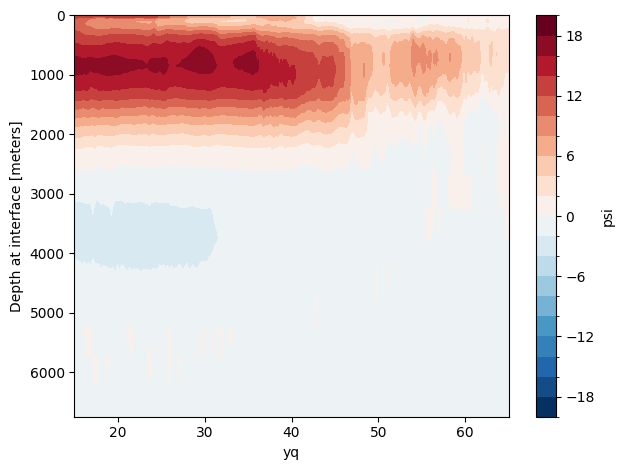

In [45]:
amoc_ctrl.sel(time=slice('1981','2007')).mean('time').plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([15,65])

## Computing AMOC myself

In [46]:
amoc_my = ds['unparameterized'].AMOC

generating basin codes


Text(0.5, 1.05, 'Zero AMOC isoline compares better to Marzocchi 2014 (3000m) for lower plot\n But upper plot compares better to Adcroft2019 ')

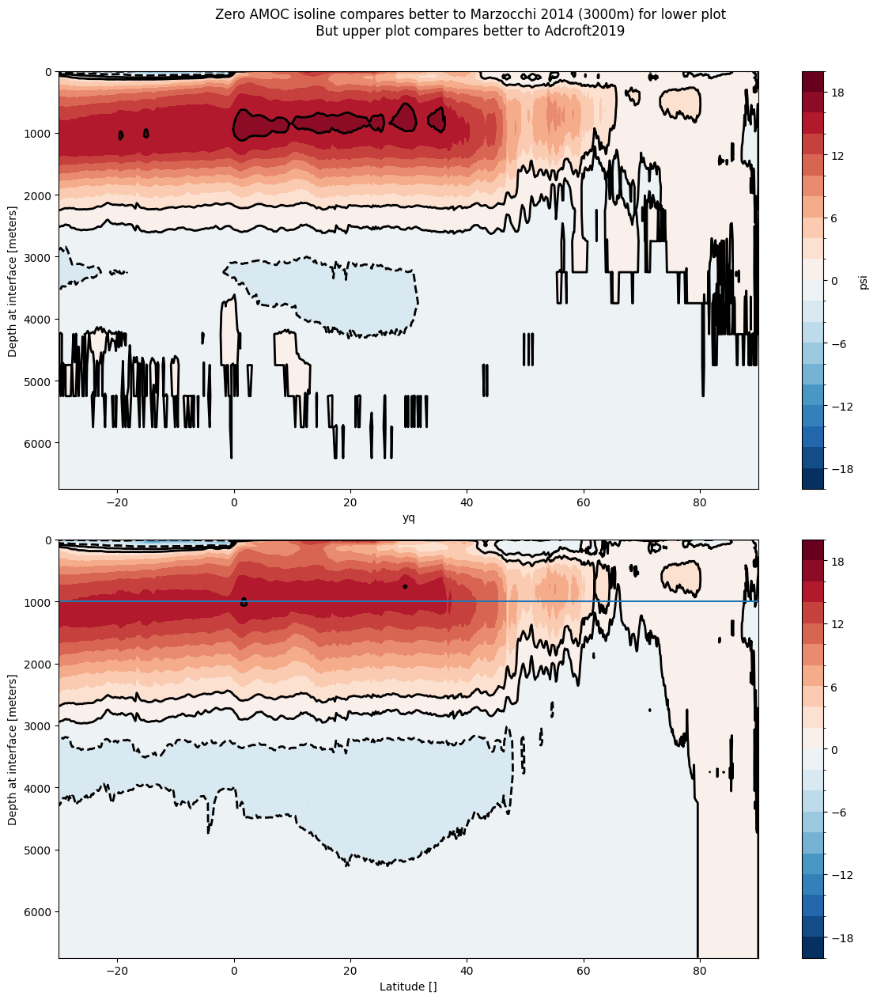

In [76]:
plt.figure(figsize=(12,12))

plt.subplot(2,1,1)
amoc_ctrl.sel(time=slice('1981','2007')).mean('time').plot.contourf(levels=np.arange(-20,22,2))
amoc_ctrl.sel(time=slice('1981','2007')).mean('time').plot.contour(levels=[-2, 0, 2, 16], colors='k', linewidths=2)
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])

plt.subplot(2,1,2)
amoc_my.plot.contourf(levels=np.arange(-20,22,2))
amoc_my.plot.contour(levels=[-2, 0, 2, 16], colors='k', linewidths=2)
plt.gca().invert_yaxis()
plt.tight_layout()
plt.axhline(y=1000)
plt.xlim([-30,None])

plt.suptitle('Zero AMOC isoline compares better to Marzocchi 2014 (3000m) for lower plot\n But upper plot compares better to Adcroft2019 ', y=1.05)

In [55]:
amoc_ctrl.sel(time=slice('1981', '2007')).mean('time').max()

<xarray.DataArray 'psi' ()> Size: 4B
array(17.242277, dtype=float32)

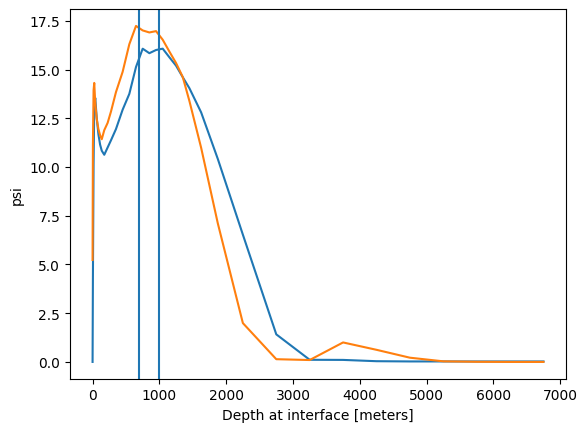

In [64]:
amoc_my.max('yq').plot()
amoc_ctrl.sel(time=slice('1981', '2007')).mean('time').max('yq').plot()
plt.axvline(x=1000)
plt.axvline(x=700)

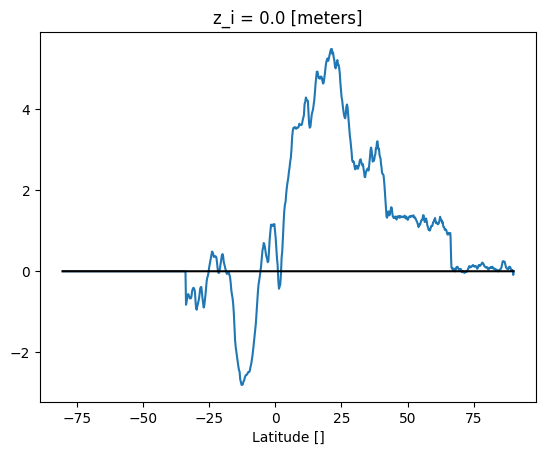

In [49]:
amoc_ctrl.isel(z_i=0,time=-1).plot()
amoc_my.isel(z_i=0).plot(color='k')

# Map of what contributes to AMOC

In [217]:
amoc_map = ds['ANN'].AMOC_map

generating basin codes


In [218]:
amoc = ds['ANN'].AMOC

generating basin codes


In [219]:
mask = ds['unparameterized'].param.wet_v
mask = xr.where(mask==0., np.nan, 1.)
therm_true = ds['unparameterized'].woa_temp.isel(zl=9).sel(xh=slice(None,-40))

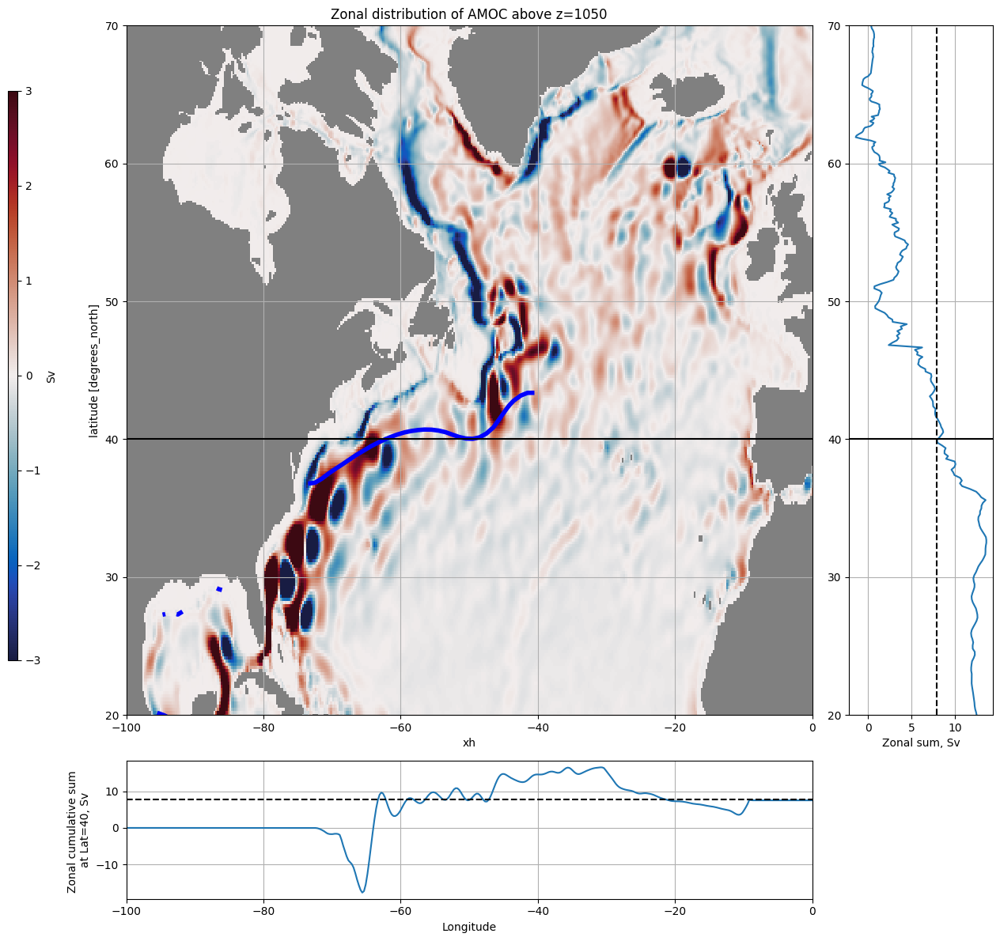

In [220]:
# This is transport above the inteface
from matplotlib.gridspec import GridSpec
z_i = 19 # 1050m
map = amoc_map.isel(z_i=z_i) * mask
lat = 40
lat_transport = map.sel(yq=lat, method='nearest').sum('xh')

depth = int(amoc.z_i[z_i])
fig = plt.figure(figsize=(12, 12))
gs = GridSpec(5, 5, figure=fig)  # Divide into 5 columns: 4 for pcolormesh, 1 for the line plot

cmap = cmocean.cm.balance
cmap.set_bad('gray')

ax = fig.add_subplot(gs[:4, :4])
im = (map).plot.pcolormesh(ax=ax, cmap=cmap, add_colorbar=False, vmin=-3)
contours = therm_true.plot.contour(ax=ax, colors='b', linewidths=4, levels=[15])
#plt.clabel(contours, inline=True, fontsize=6, fmt="GS track")

cax = fig.add_axes([-0.05,0.3,0.01,0.6])
plt.colorbar(im, cax=cax, label='Sv')
ax.set_ylim([20,70])
ax.set_xlim([-100,0])
ax.grid()
ax.set_title(f'Zonal distribution of AMOC above z={depth}')
ax.axhline(y=lat, color='k')

ax = fig.add_subplot(gs[:4, 4:])
map.sum('xh').plot(y='yq', ax=ax)
ax.set_xlabel(f'Zonal sum, Sv')
ax.set_title('')
ax.set_ylim([20,70])
ax.set_ylabel('')
ax.axhline(y=lat, color='k')
plt.grid()
ax.axvline(x=lat_transport,color='k',ls='--')

ax = fig.add_subplot(gs[4:, :4])
map.sel(yq=lat, method='nearest').cumsum('xh').plot(x='xh', ax=ax)
ax.axhline(y=lat_transport,color='k',ls='--')
ax.set_ylabel(f'Zonal cumulative sum \nat Lat={lat}, Sv')
ax.set_xlabel('Longitude')
ax.set_title('')
ax.set_xlim([-100,0])
plt.grid()
plt.tight_layout()
plt.savefig('AMOC-ANN-above.png', dpi=200)

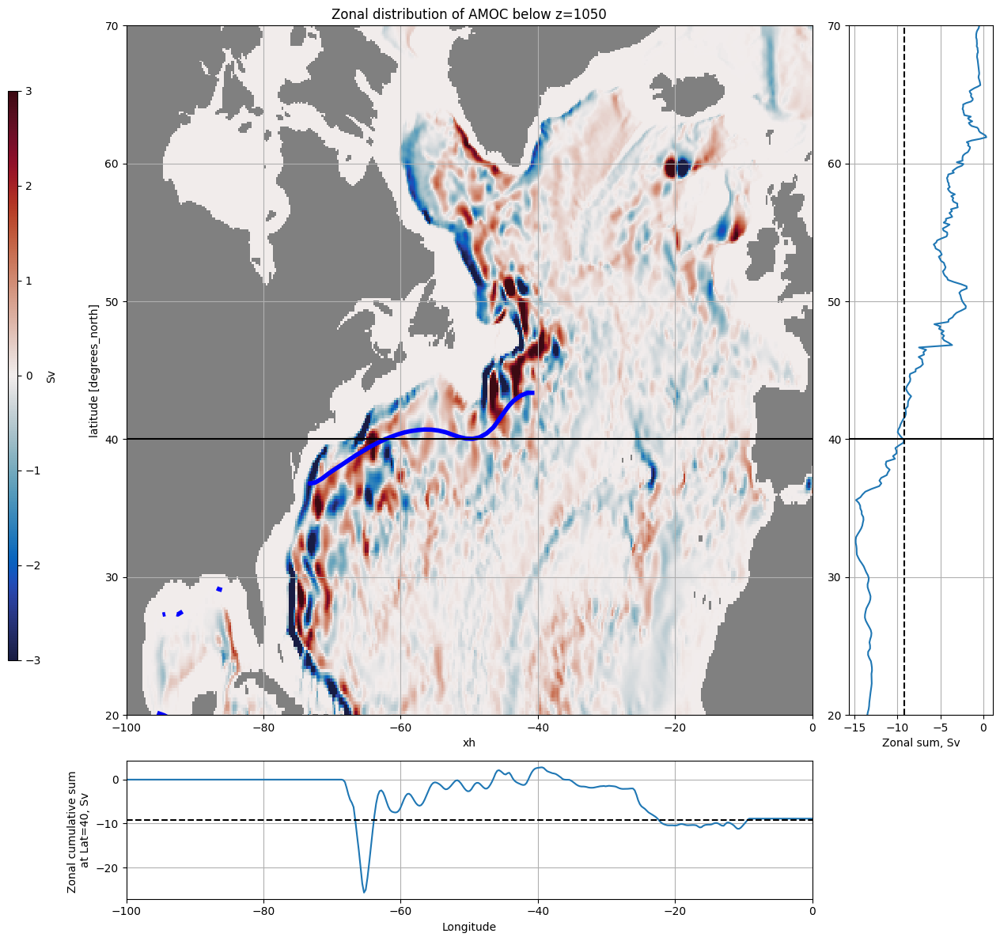

In [221]:
# This is transport above the inteface
from matplotlib.gridspec import GridSpec
z_i = 19 # 1050m
map = (amoc_map.isel(z_i=-1) - amoc_map.isel(z_i=z_i)) * mask
lat = 40
lat_transport = map.sel(yq=lat, method='nearest').sum('xh')

depth = int(amoc.z_i[z_i])
fig = plt.figure(figsize=(12, 12))
gs = GridSpec(5, 5, figure=fig)  # Divide into 5 columns: 4 for pcolormesh, 1 for the line plot

cmap = cmocean.cm.balance
cmap.set_bad('gray')

ax = fig.add_subplot(gs[:4, :4])
im = (map).plot.pcolormesh(ax=ax, cmap=cmap, add_colorbar=False, vmin=-3)
contours = therm_true.plot.contour(ax=ax, colors='b', linewidths=4, levels=[15])
cax = fig.add_axes([-0.05,0.3,0.01,0.6])
plt.colorbar(im, cax=cax, label='Sv')
ax.set_ylim([20,70])
ax.set_xlim([-100,0])
ax.grid()
ax.set_title(f'Zonal distribution of AMOC below z={depth}')
ax.axhline(y=lat, color='k')

ax = fig.add_subplot(gs[:4, 4:])
map.sum('xh').plot(y='yq', ax=ax)
ax.set_xlabel(f'Zonal sum, Sv')
ax.set_title('')
ax.set_ylim([20,70])
ax.set_ylabel('')
ax.axhline(y=lat, color='k')
plt.grid()
ax.axvline(x=lat_transport,color='k',ls='--')

ax = fig.add_subplot(gs[4:, :4])
map.sel(yq=lat, method='nearest').cumsum('xh').plot(x='xh', ax=ax)
ax.axhline(y=lat_transport,color='k',ls='--')
ax.set_ylabel(f'Zonal cumulative sum \nat Lat={lat}, Sv')
ax.set_xlabel('Longitude')
ax.set_title('')
ax.set_xlim([-100,0])
plt.grid()
plt.tight_layout()
plt.savefig('AMOC-ANN-below.png', dpi=200)

# Ocean currents

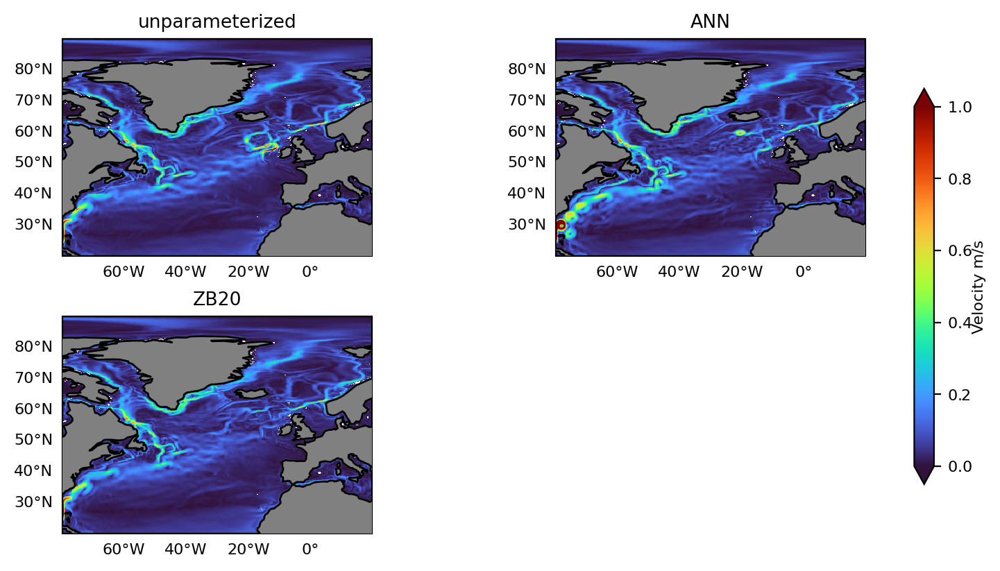

In [64]:
ds.plot_uabs(['unparameterized', 'ANN', 'ZB20'], select=select_NA_Jenny, overlay_psi=False)

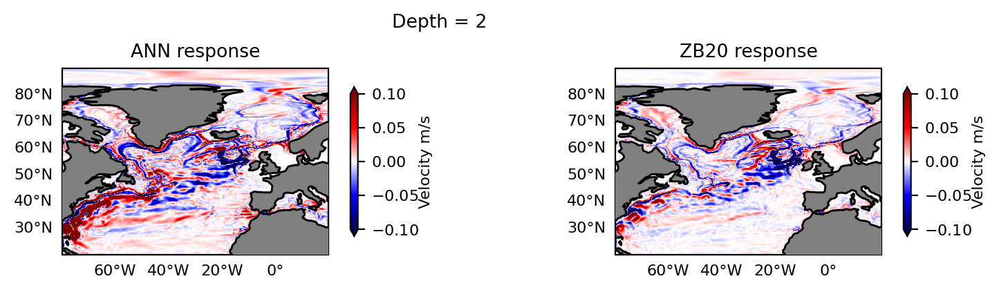

In [90]:
ds.plot_uabs(['ANN', 'ZB20'], select=select_NA_Jenny, plot_type='response')

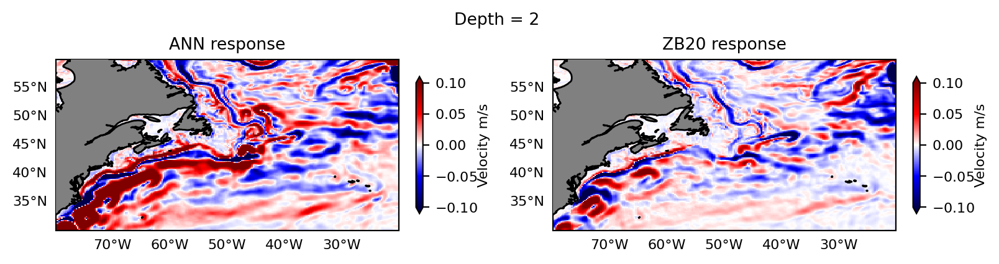

In [83]:
ds.plot_uabs(['ANN', 'ZB20'], select=select_Gulf, plot_type='response')

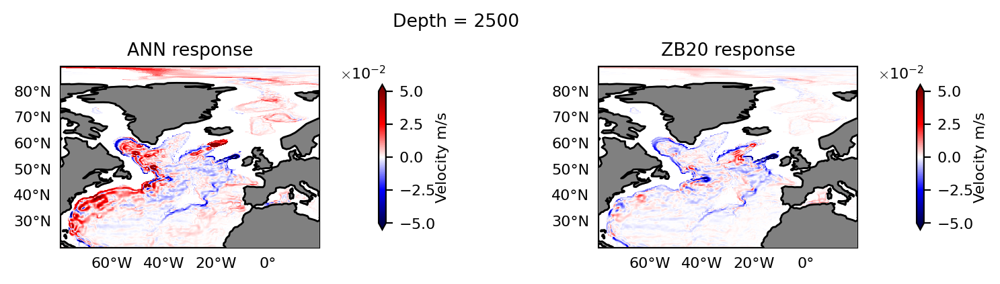

In [82]:
ds.plot_uabs(['ANN', 'ZB20'], select=select_NA_Jenny, plot_type='response', zl=26, vmax=0.05) # 2500m depth

# Shorter simulations

In [84]:
ds = CollectionOfExperiments.init_folder('/scratch/pp2681/mom6/OM4_SIS2')

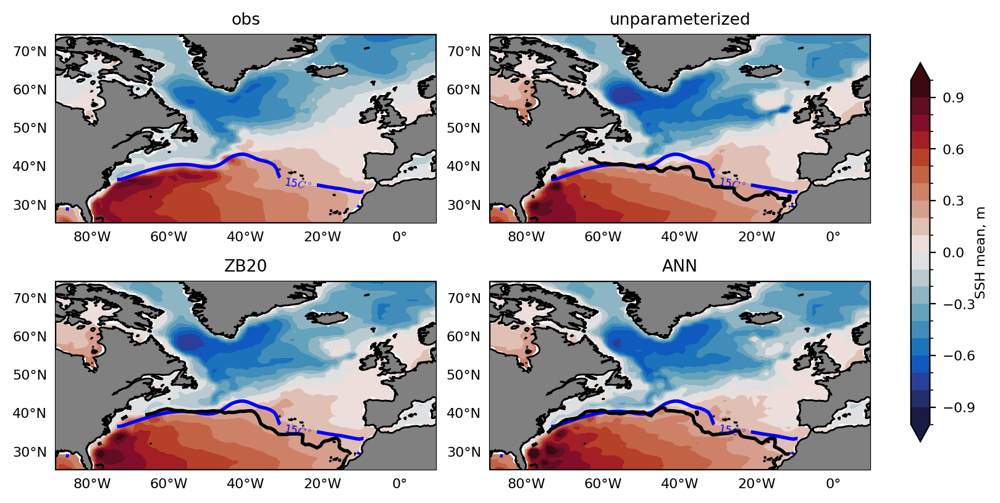

In [85]:
ds.plot_ssh_mean(['obs', 'unparameterized', 'ZB20-Klower', 'ANN-greenline'], 
                 labels=['obs', 'unparameterized', 'ZB20', 'ANN'],
                 select=select_NA_Marzocchi, isotherm_15=True)

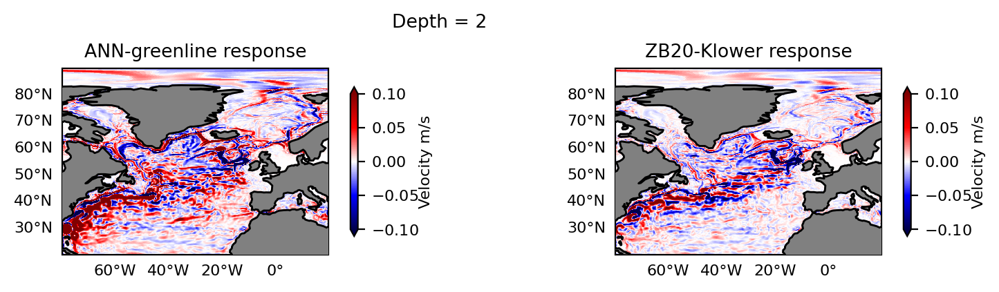

In [88]:
ds.plot_uabs(['ANN-greenline', 'ZB20-Klower'], select=select_NA_Jenny, plot_type='response')

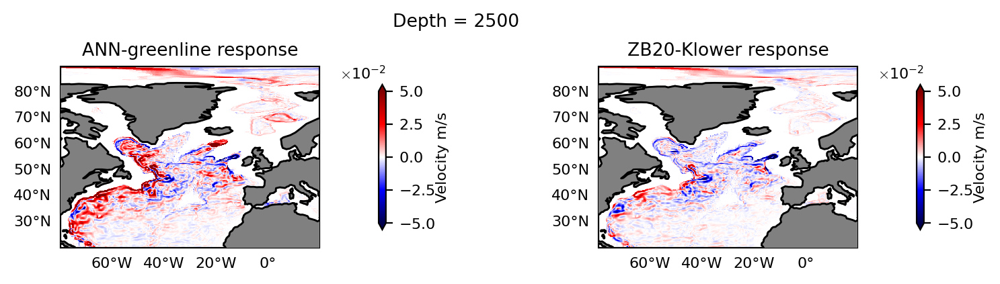

In [87]:
ds.plot_uabs(['ANN-greenline', 'ZB20-Klower'], select=select_NA_Jenny, plot_type='response', zl=26, vmax=0.05)

# AMOC comparison

In [13]:
ds_long = CollectionOfExperiments.init_folder('/scratch/js15017/OM4_storage/CORE-AIF-runs', additional_subfolder='', Averaging_time=slice('1981', None))

In [14]:
ds_short = CollectionOfExperiments.init_folder('/scratch/pp2681/mom6/OM4_SIS2')

In [23]:
amoc = ds_long['unparameterized'].AMOC.compute()
amoc_zb = ds_long['ZB20'].AMOC.compute()
amoc_ann = ds_long['ANN'].AMOC.compute()

generating basin codes
generating basin codes
generating basin codes


In [26]:
amoc_short = ds_short['unparameterized'].AMOC.compute()
amoc_zb_short = ds_short['ZB20-Klower'].AMOC.compute()
amoc_ann_short = ds_short['ANN-greenline'].AMOC.compute()

generating basin codes
generating basin codes
generating basin codes


Text(0.5, 0.98, 'Profile at 26N')

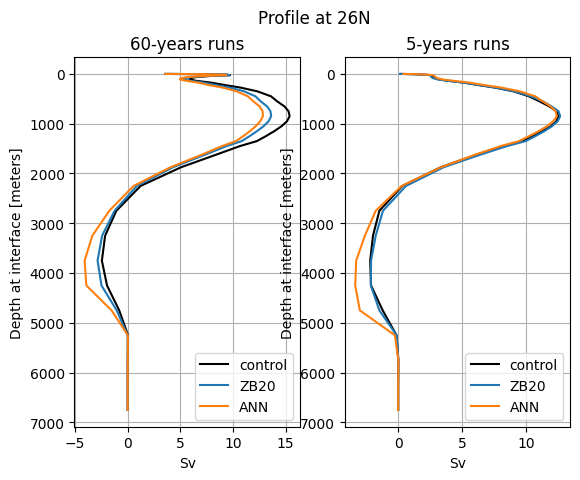

In [29]:
plt.subplot(1,2,1)
amoc.sel(yq=26,method='nearest').plot(color='k', y='z_i', label='control')
amoc_zb.sel(yq=26,method='nearest').plot(y='z_i', label='ZB20')
amoc_ann.sel(yq=26,method='nearest').plot(y='z_i', label='ANN')
plt.gca().invert_yaxis()
plt.grid()
plt.title('60-years runs')
plt.xlabel('Sv')
plt.legend()

plt.subplot(1,2,2)
amoc_short.sel(yq=26,method='nearest').plot(color='k', y='z_i', label='control')
amoc_zb_short.sel(yq=26,method='nearest').plot(y='z_i', label='ZB20')
amoc_ann_short.sel(yq=26,method='nearest').plot(y='z_i', label='ANN')
plt.gca().invert_yaxis()
plt.grid()
plt.title('5-years runs')
plt.xlabel('Sv')
plt.legend()
plt.suptitle('Profile at 26N')

# Can the temperature response pattern be explained by change in horizontal current?
Let's assume that the change in temperature is small and secondary, and change is mostly forced by change in mean currents then
$$
\partial_t T_{old} + \nabla (\mathbf{u}_{old} * T_{old}) = 0
$$
and
$$
\partial_t T_{new} + \nabla (\mathbf{u}_{new} * T_{old}) = 0
$$
Then, additional forcing or response is:
$$
\partial_t \delta T = - \nabla (\delta \mathbf{u} * T_{old})
$$

If this is true, then response pattern is local

In [32]:
t_old = ds_long['unparameterized'].ocean_annual_z.thetao.sel(time=slice('1981', '2007')).mean('time').compute()

In [33]:
du = (ds_long['ZB20'].ocean_annual_z.uo - ds_long['unparameterized'].ocean_annual_z.uo ).sel(time=slice('1981', '2007')).mean('time').compute()

In [34]:
dv = (ds_long['ZB20'].ocean_annual_z.vo - ds_long['unparameterized'].ocean_annual_z.vo ).sel(time=slice('1981', '2007')).mean('time').compute()

In [38]:
from helpers.computational_tools import *
param = ds['unparameterized'].param
grid = create_grid_global(param)

In [126]:
dtdx = grid.interp(grid.diff(t_old,'X') / param.dxCu,'X')
dtdy = grid.interp(grid.diff(t_old,'Y') / param.dyCv,'Y')

response = - dtdx * grid.interp(du,'X') - dtdy * grid.interp(dv,'Y')

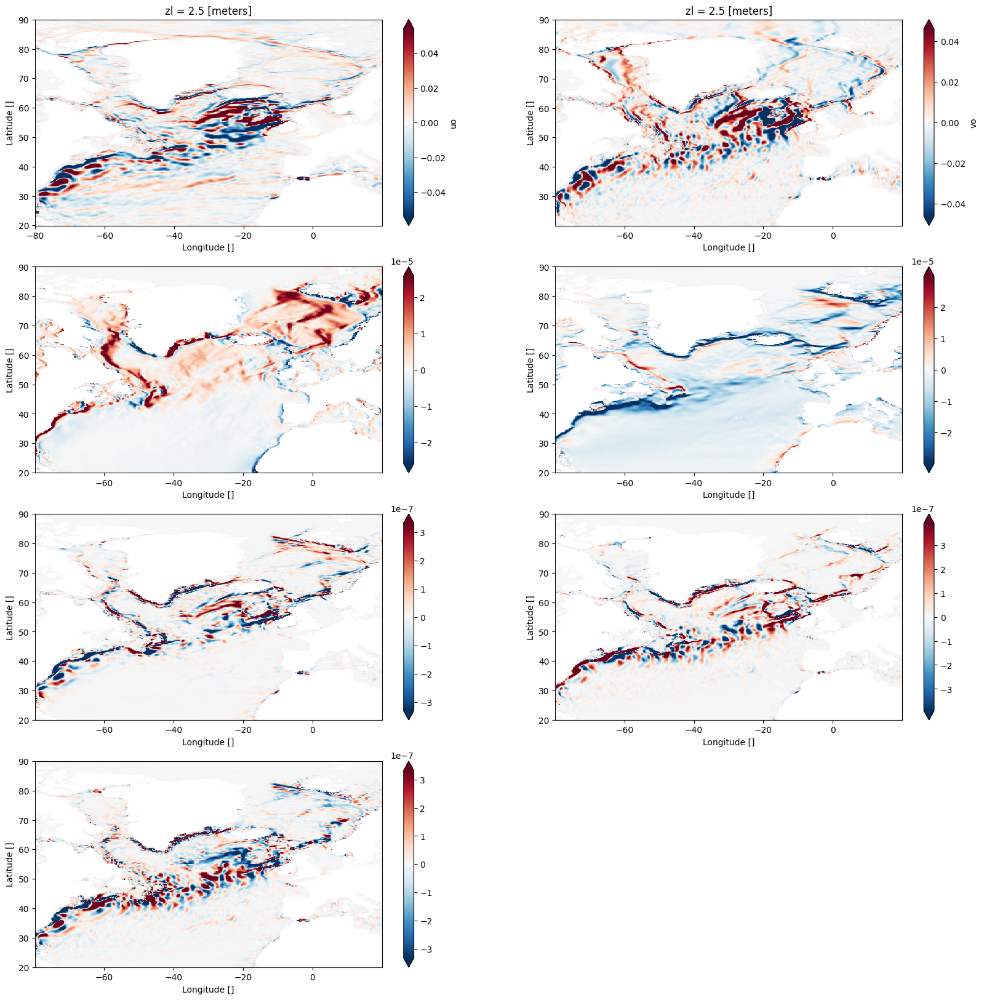

In [130]:
plt.figure(figsize=(20,20))
plt.subplot(4,2,1)
select_NA_Jenny(du.isel(zl=0)).plot(robust=True)
plt.subplot(4,2,2)
select_NA_Jenny(dv.isel(zl=0)).plot(robust=True)
plt.subplot(4,2,3)
select_NA_Jenny(dtdx.isel(zl=0)).plot(robust=True)
plt.subplot(4,2,4)
select_NA_Jenny(dtdy.isel(zl=0)).plot(robust=True)
plt.subplot(4,2,5)
select_NA_Jenny(dtdx * grid.interp(du,'X')).isel(zl=0).plot(robust=True)
plt.subplot(4,2,6)
select_NA_Jenny(dtdy * grid.interp(dv,'Y')).isel(zl=0).plot(robust=True)
plt.subplot(4,2,7)
select_NA_Jenny(response).isel(zl=0).plot(robust=True)

# Calibrate GS and NAC path

In [16]:
ds = CollectionOfExperiments.init_folder('/scratch/js15017/OM4_storage/CORE-AIF-runs', additional_subfolder='', Averaging_time=slice('1981', '2007'))

In [60]:
ds_short = CollectionOfExperiments.init_folder('/scratch/pp2681/mom6/OM4_SIS2')

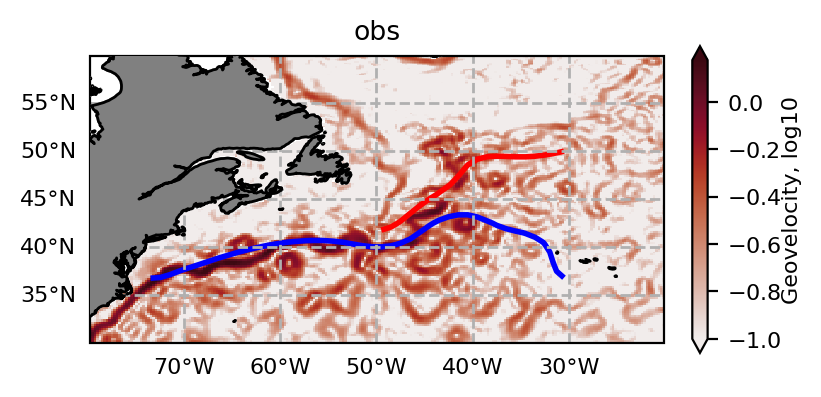

In [108]:
ds.plot_geovel(['obs'], select=select_Gulf, gridlines=True, GS_NAC=True)

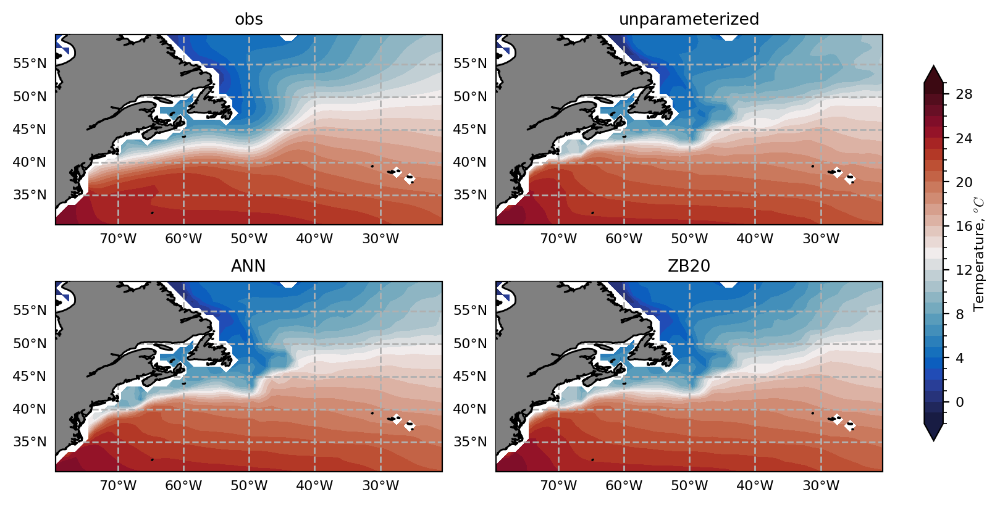

In [103]:
ds.plot_temp(['obs', 'unparameterized','ANN', 'ZB20'], select=select_Gulf, gridlines=True, GS_NAC=False, zl=0, plot_type='default')

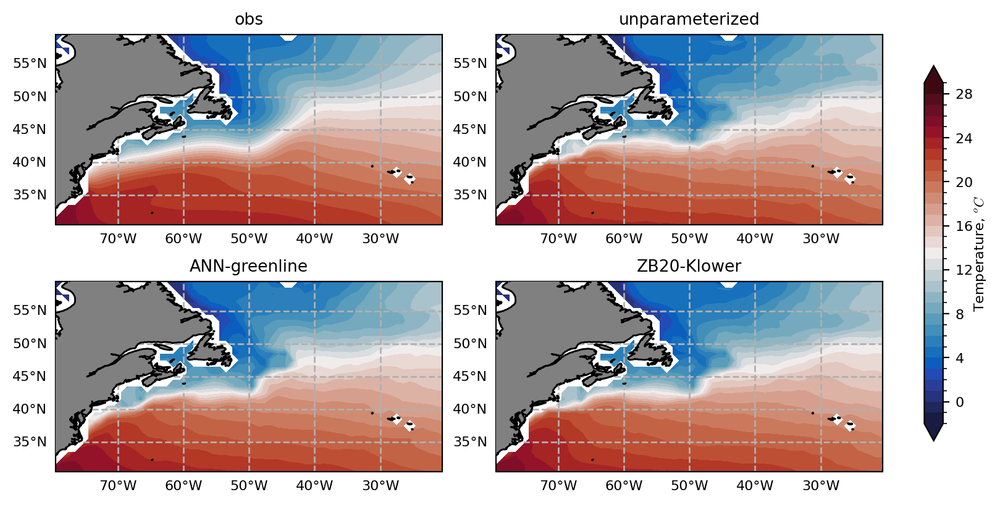

In [104]:
ds_short.plot_temp(['obs', 'unparameterized','ANN-greenline', 'ZB20-Klower'], select=select_Gulf, gridlines=True, GS_NAC=False, zl=0, plot_type='default')

# Relative voritcity of vorticies near the coast are sign-definite?

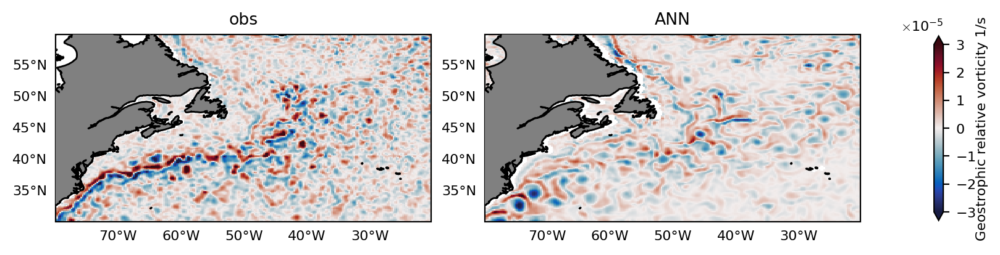

In [12]:
ds.plot_geoRV(['obs', 'ANN'], select=select_Gulf)

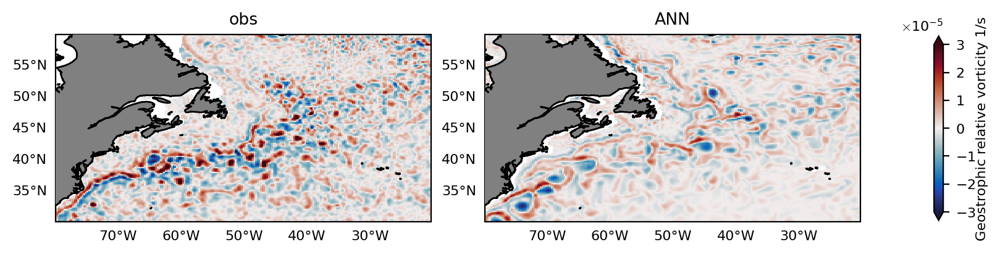

In [8]:
ds.plot_geoRV(['obs', 'ANN'], select=select_Gulf, idx=10)

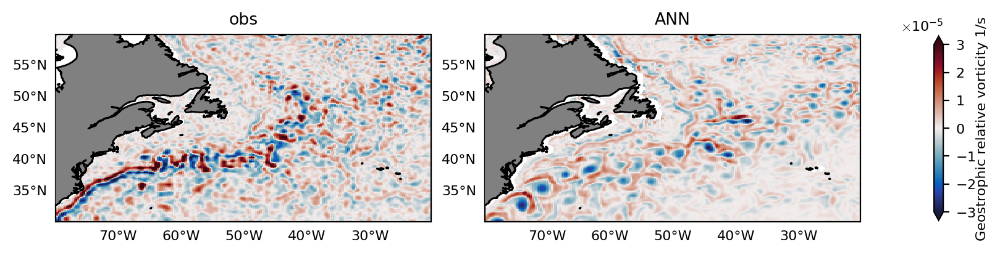

In [9]:
ds.plot_geoRV(['obs', 'ANN'], select=select_Gulf, idx=50)

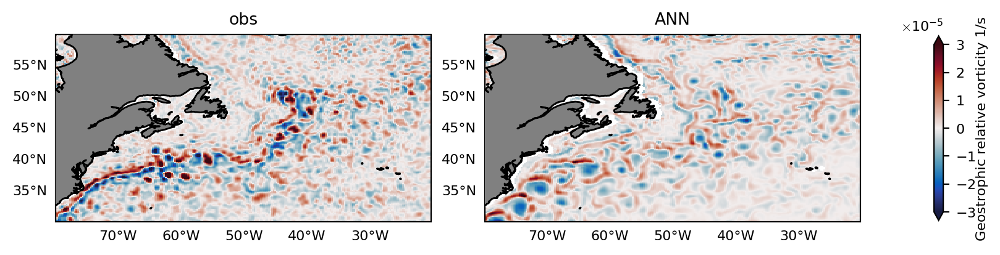

In [10]:
ds.plot_geoRV(['obs', 'ANN'], select=select_Gulf, idx=80)

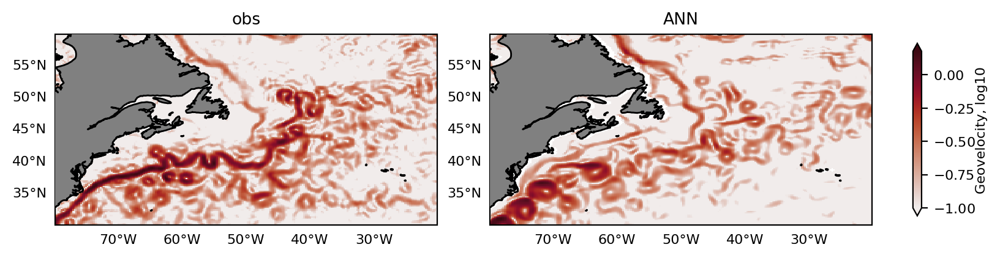

In [15]:
ds.plot_geovel(['obs', 'ANN'], select=select_Gulf, idx=80)

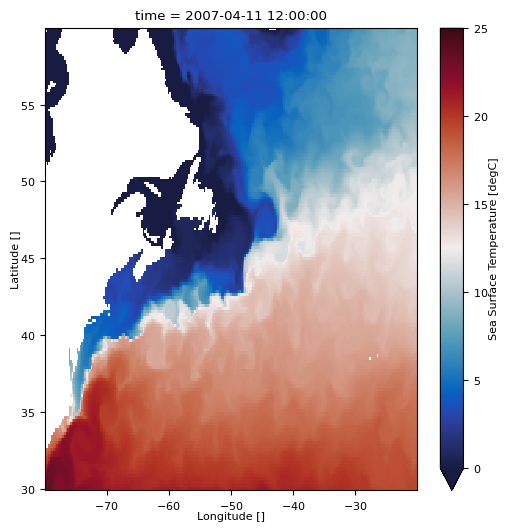

In [31]:
select_Gulf(ds['ANN'].ocean_daily.tos.isel(time=100)).plot(vmin=0,vmax=25, cmap=cmocean.cm.balance)

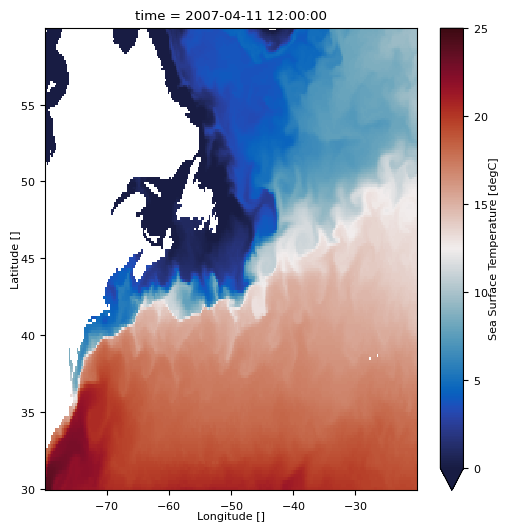

In [32]:
select_Gulf(ds['unparameterized'].ocean_daily.tos.isel(time=100)).plot(vmin=0,vmax=25, cmap=cmocean.cm.balance)

In [29]:
# All eddies near the coast seem to have negative vorticity
# Gulf stream rings (i.e. eddies separated from Gulf Stream) must be cold and rotating counterclockwise https://rwu.pressbooks.pub/webboceanography/chapter/9-2-the-gulf-stream/
# It does not seem I see any actual rings in the solution